<a href="https://colab.research.google.com/github/kdubovikov/hackernews-analysis/blob/master/hackernews_analytics_public.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Hackernews data analysis

We will use Hackernews data to answer the following questions:

* What is the best time to post on HN?
* What common topics are present in low- and top-performing HN posts?

This is a companion notebook that contains code for [this blogpost](https://test.test).

The cell below will install necessary libraries and then **stop the kernel** to avoid version conflicts.

In [1]:
!pip install -q -U wordcloud
!pip install -q -U statsmodels
!pip install -q -U gensim
!pip install -q -U pyldavis

#!wget --tries 5 http://mallet.cs.umass.edu/dist/mallet-2.0.8.zip
#!unzip mallet-2.0.8.zip

!pip install -q -U llvmlite
!pip install -q top2vec[sentence_transformers]

# install latest UMAP from git to fix AttributeError on import inside top2vec 
!git clone https://github.com/lmcinnes/umap
!cd umap && pip install -q --user -r requirements.txt && python setup.py install --user

# fix hdbscan using deprecated joblib option
!git clone https://github.com/scikit-learn-contrib/hdbscan.git
!cd hdbscan && pip install -q --user -r requirements.txt && python setup.py install --user

!pip install -q -U numba

# restart env to fix top2vec import errors
import sys
# sys.exit(1)

ERROR: top2vec 1.0.25 has requirement gensim<4.0.0, but you'll have gensim 4.0.1 which is incompatible.
fatal: destination path 'umap' already exists and is not an empty directory.
running install
running bdist_egg
running egg_info
writing umap_learn.egg-info/PKG-INFO
writing dependency_links to umap_learn.egg-info/dependency_links.txt
writing requirements to umap_learn.egg-info/requires.txt
writing top-level names to umap_learn.egg-info/top_level.txt
adding license file 'LICENSE.txt'
writing manifest file 'umap_learn.egg-info/SOURCES.txt'
installing library code to build/bdist.linux-x86_64/egg
running install_lib
running build_py
creating build/bdist.linux-x86_64/egg
creating build/bdist.linux-x86_64/egg/umap
copying build/lib/umap/validation.py -> build/bdist.linux-x86_64/egg/umap
copying build/lib/umap/__init__.py -> build/bdist.linux-x86_64/egg/umap
copying build/lib/umap/parametric_umap.py -> build/bdist.linux-x86_64/egg/umap
copying build/lib/umap/utils.py -> build/bdist.linux-x8

In [2]:
import pandas as pd
import seaborn as sns
import numpy as np
from sklearn.model_selection import train_test_split

np.random.seed(42)

# Best hour to post analysis

To find best hours to post we will do explorotary data analysis as well as regression modelling. I have written a scraper that collects all HN data. In this notebook we will use a snapshot of the database containing posts from 2020-11-07 up to 2020-12-18.

In [3]:
#@title Preprocessing settings
timezone = "EST" #@param {type:"string"}

## Data preparation

In [4]:
!gdown -O /tmp/hn.sqlite --id 18jxI2y9wRfKxolubqSvfkAA1k8hFTuRA
print('Download complete')

Downloading...
From: https://drive.google.com/uc?id=18jxI2y9wRfKxolubqSvfkAA1k8hFTuRA
To: /tmp/hn.sqlite
190MB [00:02, 87.5MB/s]
Download complete


In [4]:
import pandas as pd
import sqlite3

pd.options.display.max_rows = 999

con = sqlite3.connect('/tmp/hn.sqlite')

latest_news_scores = """
select * from news
join (
  select max(score) as score, news_id from news_scores
  group by news_id
  order by created_at desc
)
  s on s.news_id = news.id
"""

news_scores_count = """
select news_id, count(*) as count from news_scores
group by news_id
order by count desc
"""

all_scores = """
select * from news_scores
"""

scores = """
select * from news_scores
where news_id = {}
order by created_at desc
"""

In [5]:
news_scores = pd.read_sql_query('select * from news_scores', con, parse_dates=['created_at'])
news = pd.read_sql_query('select * from news', con, parse_dates=['created_at', 'last_updated'])

In [6]:
!git clone https://github.com/massanishi/hackernews-post-datasets.git

fatal: destination path 'hackernews-post-datasets' already exists and is not an empty directory.


In [7]:
from pathlib import Path
from tqdm.notebook import tqdm

hn_historic_data = pd.DataFrame()

for file in tqdm(Path('hackernews-post-datasets').glob('*.json')):
  df = pd.read_json(file)
  hn_historic_data = pd.concat([hn_historic_data, df], axis=0)

hn_historic_data['time'] = pd.to_datetime(hn_historic_data['time'], unit='s', origin='unix')
hn_historic_data.reset_index(inplace=True)

## Exploratory data analysis

In [ ]:
news_data_samples = news_scores[['news_id', 'created_at']].groupby('news_id').count().query('created_at > 5')
news_data_samples.describe()

,created_at
count,3644.000000
mean,34.413282
std,24.886189
min,6.000000
25%,15.000000
50%,28.000000
75%,48.000000
max,189.000000


In [ ]:
news_data_samples = news_scores[news_scores.news_id.isin(news_data_samples.index.tolist())]

In [ ]:
groups = []
for g in news_data_samples[['news_id', 'created_at', 'score']].set_index('created_at').groupby('news_id'):
    groups.append(g[1])

In [ ]:
def remove_borders(ax):
    for loc in ['top', 'right', 'left', 'bottom']:
        ax.spines[loc].set_visible(False)

<Figure size 432x288 with 0 Axes>

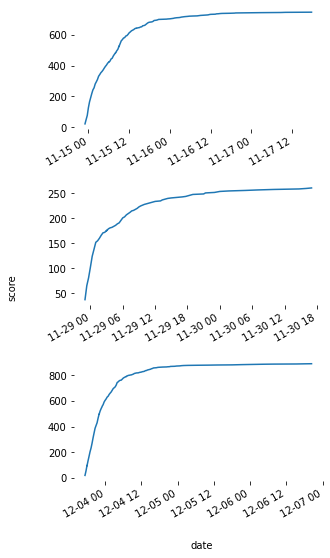

In [ ]:
import matplotlib.pyplot as plt
plt.set_cmap('jet')

N_SCORE_PLOTS = 3

fig, ax = plt.subplots(N_SCORE_PLOTS, 1, figsize=(5, 3 * N_SCORE_PLOTS))
fig.text(-0.01, 0.5, 'score', va='center', rotation='vertical')
fig.text(0.5, 0.1, 'date', va='center')
fig.tight_layout(pad=4)

for i in range(0, N_SCORE_PLOTS):
    id = np.random.randint(0, len(groups))
    series = groups[id]['score']
    remove_borders(ax[i])
    series.plot(xlabel='', ax=ax[i])

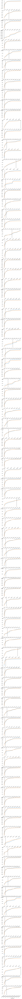

In [ ]:
import matplotlib.pyplot as plt

N_plots = 100
fig, ax = plt.subplots(N_plots, 1, figsize=(5, 3 * N_plots))

score_intervals = []

for i in range(0, N_plots):
    sample_id = np.random.randint(0, len(groups))
    series = groups[sample_id]['score']
    series = series / np.max(series)
    
    # fit log function
    x = np.asarray(list(range(0, len(series))))
    y = series.tolist()
    a, b = np.polyfit(np.log(x + 1), y, 1)
    log_fit = np.array([a * np.log(xx) + b for xx in x + 1])
    
    # plot original and log funtcion
    series.plot(ax=ax[i])
    ax[i].plot(series.index, log_fit)

    # find time interval for largest part of the upvotes
    min_idx = np.argwhere(np.diff(log_fit) < 0.05)
    if len(min_idx) > 0:
        end_interval = series.index[min_idx[0]].to_pydatetime()[0]
    else:
        end_interval = series.index[-1].to_pydatetime()

    ax[i].axvline(end_interval, color='k', linestyle='--')
    remove_borders(ax[i])
    score_intervals.append(end_interval - series.index[0])


In [ ]:
pd.Series(score_intervals).median(), pd.Series(score_intervals).mean(), pd.Series(score_intervals).std()

(Timedelta('0 days 01:39:56.868480500'),
 Timedelta('0 days 02:05:48.311424470'),
 Timedelta('0 days 01:51:14.907849205'))

In [8]:
import numpy as np
from datetime import datetime

def latest_score(scores):
  return scores[-1]

def hn_rank(scores, g=1.8):
  """See https://medium.com/hacking-and-gonzo/how-hacker-news-ranking-algorithm-works-1d9b0cf2c08d"""
  if len(scores) == 1:
    time = (datetime.now() - scores.index[0]).total_seconds()
  else:
    time = (scores.index[-1] - scores.index[0]).total_seconds()
  time /= 3600
  return (scores[-1] - 1) / np.power(time + 2, g)

def rank(scores, gamma=0.9, alpha=0.95):
  if len(scores) == 1:
    return -1
  else:
    rank = 0
    for i in range(1, len(scores)):
      time = (scores.index[i] - scores.index[i - 1]).total_seconds()
      velocity = (scores[i] - scores[i - 1]) / time
      rank = gamma * rank + alpha * velocity
    return rank

score_ranking = news_scores[['news_id', 'created_at', 'score']].set_index('created_at').groupby('news_id').agg(latest_score)
ranked_news = pd.merge(score_ranking, news, left_index=True, right_on='id').sort_values('score', ascending=False)
ranked_news = pd.concat([ranked_news[['created_at', 'score']], hn_historic_data[['time', 'score']].rename({'time': 'created_at'}, axis=1)])
ranked_news.created_at = ranked_news.created_at.dt.tz_localize('UTC')
ranked_news.created_at = ranked_news.created_at.dt.tz_convert(timezone)
#ranked_news.last_updated = ranked_news.last_updated.dt.tz_localize('UTC')
#ranked_news.last_updated = ranked_news.last_updated.dt.tz_convert(timezone)
ranked_news['hour_posted'] = ranked_news['created_at'].dt.hour
ranked_news['weekday_posted'] = ranked_news['created_at'].dt.weekday
ranked_news.dropna(inplace=True)
ranked_news.head(10)

,created_at,score,hour_posted,weekday_posted
4665,2020-12-16 18:20:27.083914-05:00,2762.0,18,2
939,2020-11-15 19:20:18.599892-05:00,2626.0,19,6
574,2020-11-11 21:20:20.178115-05:00,2600.0,21,2
2221,2020-11-26 01:00:18.475323-05:00,2339.0,1,3
4225,2020-12-13 23:00:25.206636-05:00,2312.0,23,6
3652,2020-12-10 03:00:29.834095-05:00,2106.0,3,3
155,2020-11-09 08:00:21.122876-05:00,1882.0,8,0
3705,2020-12-08 15:00:32.136974-05:00,1747.0,15,1
260,2020-11-08 10:40:18.612627-05:00,1613.0,10,6
2333,2020-11-26 09:00:21.846626-05:00,1593.0,9,3


In [ ]:
ranked_news[['score']].describe()

,score
count,244170.000000
mean,93.481677
std,150.986448
min,1.000000
25%,10.000000
50%,43.000000
75%,117.000000
max,6015.000000


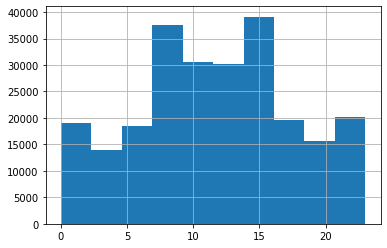

In [ ]:
ranked_news.hour_posted.hist()

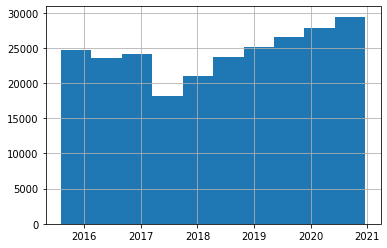

In [ ]:
ranked_news.created_at.hist()

Let's see how scores are distributed among weekdays

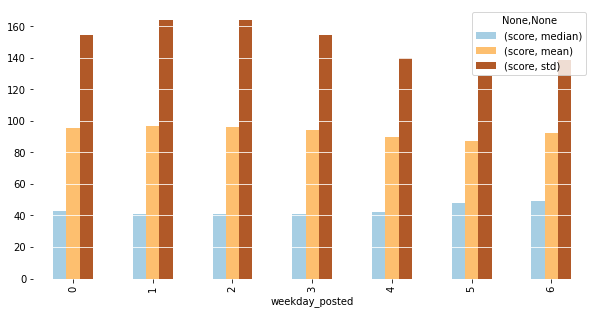

In [ ]:
ax = ranked_news[['score', 'weekday_posted']].groupby('weekday_posted').agg(['median', 'mean', 'std']).plot.bar(figsize=(10, 5), colormap="Paired")
remove_borders(ax)
plt.grid(color='white', axis='y')
ax

Now, the same visualization, but for hours

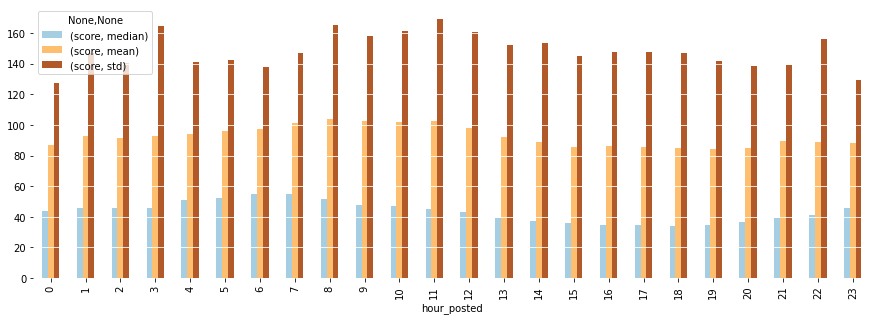

In [ ]:
ax = ranked_news[['score', 'hour_posted']].groupby('hour_posted').agg(['median', 'mean', 'std']).plot.bar(figsize=(15, 5), colormap="Paired")
remove_borders(ax)
plt.grid(color='white', axis='y')
ax

The most detailed view: score matrix for hourly scores for each day

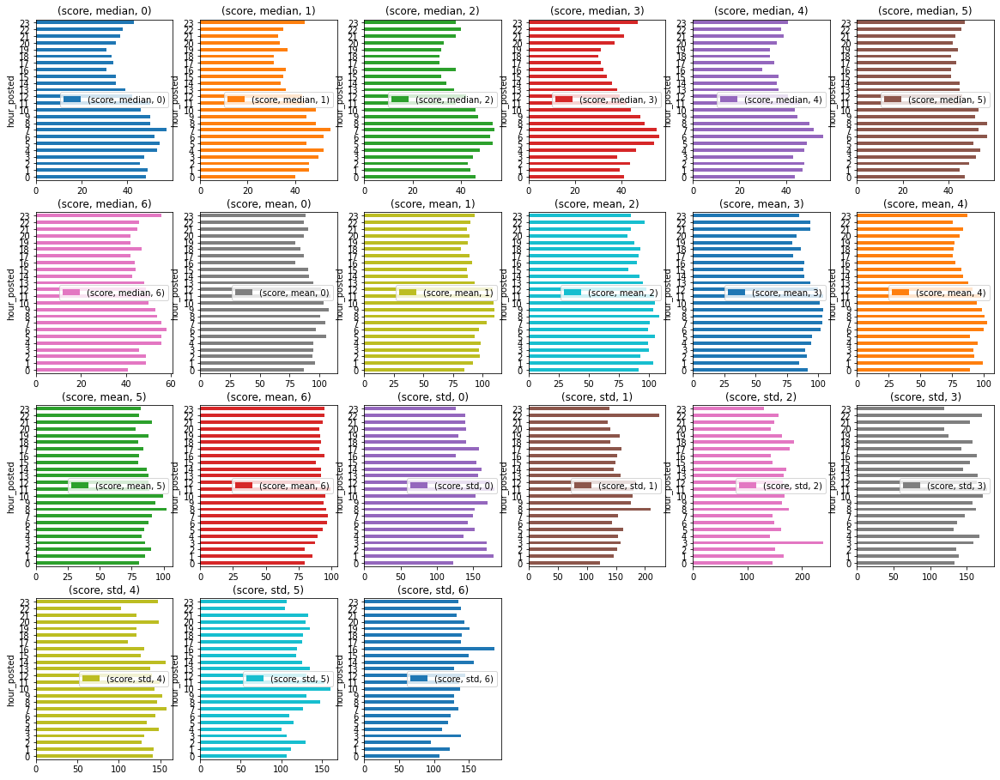

In [ ]:
ranked_news[['score', 'hour_posted', 'weekday_posted']]\
  .groupby(['hour_posted', 'weekday_posted'])\
  .agg(['median', 'mean', 'std'])\
  .unstack(level=1)\
  .plot.barh(subplots=True, figsize=(20, 20), sharex=False, layout=(5, 6));

Let's see how score distribution looks:

In [ ]:
sns.set_palette("Paired")

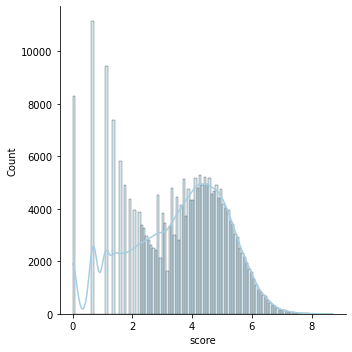

In [ ]:
sns.displot(np.log(ranked_news['score']), kde=True)
sns.despine()

In [ ]:
ranked_news.sort_values("created_at").head()

,created_at,score,hour_posted,weekday_posted
175077,2015-08-03 16:52:38-05:00,4.0,16,0
175076,2015-08-03 17:27:33-05:00,175.0,17,0
175074,2015-08-03 17:44:25-05:00,98.0,17,0
175073,2015-08-03 17:50:00-05:00,309.0,17,0
175072,2015-08-03 17:53:29-05:00,32.0,17,0


# Linear models for best posting hour

There are several possible ways to model relationship between posting hour and resulting score. We can use Possion models too, but the score distribution is actually overdispersed (std > mean), and for Possion distribution std shoud be close or equal to mean. Because of this we will start with negative binomial generalized linear model, which can be used with count data in the target variable. 

What follows below is by no means a rigorous statistical analysis. Instead we will analyze results from several different methods and see if they match with each other. In some way, we will perform model ensembling by hand 🙂



According to the Negative Binomial model, the best hour to post is 5 AM EST and 1 AM EST. This conforms with the EDA results above.

In [ ]:
import statsmodels.api as sm
import statsmodels.formula.api as smf
from matplotlib import pyplot as plt

model = smf.glm('score ~ 0 + C(hour_posted)', data=ranked_news, family=sm.families.NegativeBinomial()).fit()
pd.DataFrame(model.summary().tables[1].data[1:], columns=model.summary().tables[1].data[0]).sort_values('coef', ascending=False)

,,coef,std err,z,P>|z|,[0.025,0.975]
8,C(hour_posted)[8],4.6401,0.009,518.146,0.000,4.623,4.658
9,C(hour_posted)[9],4.6309,0.009,531.683,0.000,4.614,4.648
11,C(hour_posted)[11],4.6300,0.008,572.639,0.000,4.614,4.646
10,C(hour_posted)[10],4.6217,0.008,567.044,0.000,4.606,4.638
7,C(hour_posted)[7],4.6167,0.009,494.065,0.000,4.598,4.635
12,C(hour_posted)[12],4.5831,0.008,563.120,0.000,4.567,4.599
6,C(hour_posted)[6],4.5789,0.010,455.735,0.000,4.559,4.599
5,C(hour_posted)[5],4.5617,0.011,415.651,0.000,4.540,4.583
4,C(hour_posted)[4],4.5440,0.012,383.083,0.000,4.521,4.567
1,C(hour_posted)[1],4.5318,0.013,357.098,0.000,4.507,4.557


In [ ]:
model.summary().tables[0]

Dep. Variable:,score,No. Observations:,244170
Model:,GLM,Df Residuals:,244146
Model Family:,NegativeBinomial,Df Model:,23
Link Function:,log,Scale:,1.0000
Method:,IRLS,Log-Likelihood:,-1.3528e+06
Date:,"Wed, 20 Jan 2021",Deviance:,4.8030e+05
Time:,15:25:37,Pearson chi2:,6.31e+05
No. Iterations:,6,,
Covariance Type:,nonrobust,,


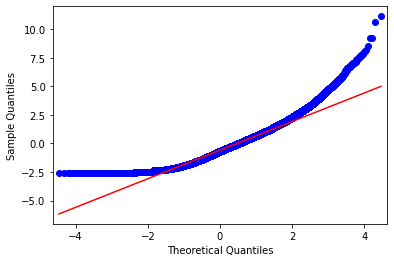

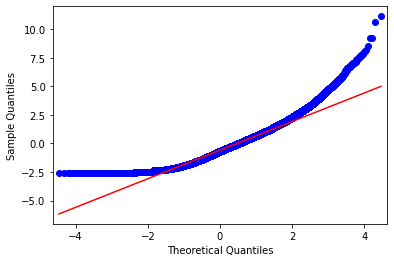

In [ ]:
from statsmodels import graphics
graphics.gofplots.qqplot(model.resid_deviance, line='r')

Best days are Mondays and Sundays, which conforms with the EDA results too.

Q-Q plots show that our residuals are not Normal. Models are not ideal, and there is a non-linear effect that is left unexplained by our data. We will partially compensate for our erroneous models by using several different modelling techniques and comparing their results. 

In [9]:
import statsmodels.api as sm
import statsmodels.formula.api as smf

model = smf.glm('score ~ 0 + C(weekday_posted)', data=ranked_news, family=sm.families.NegativeBinomial()).fit()
pd.DataFrame(model.summary().tables[1].data[1:], columns=model.summary().tables[1].data[0]).sort_values('coef', ascending=False)

,,coef,std err,z,P>|z|,[0.025,0.975]
1,C(weekday_posted)[1],4.5750,0.005,891.534,0.000,4.565,4.585
2,C(weekday_posted)[2],4.5684,0.005,888.391,0.000,4.558,4.579
0,C(weekday_posted)[0],4.5578,0.005,877.741,0.000,4.548,4.568
3,C(weekday_posted)[3],4.5432,0.005,879.076,0.000,4.533,4.553
6,C(weekday_posted)[6],4.5238,0.006,770.599,0.000,4.512,4.535
4,C(weekday_posted)[4],4.4970,0.005,839.649,0.000,4.487,4.508
5,C(weekday_posted)[5],4.4706,0.006,739.867,0.000,4.459,4.482


In [ ]:
model.summary().tables[0]

Dep. Variable:,score,No. Observations:,244170
Model:,GLM,Df Residuals:,244163
Model Family:,NegativeBinomial,Df Model:,6
Link Function:,log,Scale:,1.0000
Method:,IRLS,Log-Likelihood:,-1.3533e+06
Date:,"Wed, 20 Jan 2021",Deviance:,4.8124e+05
Time:,15:26:02,Pearson chi2:,6.25e+05
No. Iterations:,6,,
Covariance Type:,nonrobust,,


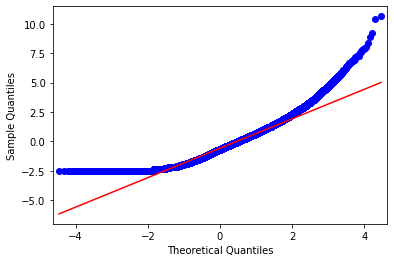

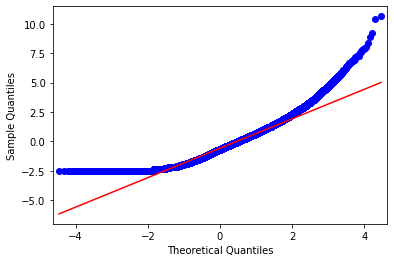

In [ ]:
from statsmodels import graphics
graphics.gofplots.qqplot(model.resid_deviance, line='r')

Now, let's look at a more complex mixed GLM model that can account for random variance effects between each weekday

In [ ]:
import statsmodels.formula.api as smf
from statsmodels.genmod.bayes_mixed_glm import PoissonBayesMixedGLM, BinomialBayesMixedGLM

model = PoissonBayesMixedGLM.from_formula('score ~ 0 + C(hour_posted)', {'weekday_posted': '0 + C(weekday_posted)'}, ranked_news)
mdf = model.fit_vb()
mdf.summary().tables[0].sort_values('Post. Mean', ascending=False)

/usr/local/lib/python3.6/dist-packages/statsmodels/genmod/bayes_mixed_glm.py:814: RuntimeWarning: overflow encountered in exp
  iv -= np.sum((vc_mean**2 + vc_sd**2) * np.exp(2 * (s**2 - m))) / 2
/usr/local/lib/python3.6/dist-packages/statsmodels/genmod/bayes_mixed_glm.py:832: RuntimeWarning: overflow encountered in exp
  ve = np.exp(2 * (s**2 - m))
/usr/local/lib/python3.6/dist-packages/statsmodels/genmod/bayes_mixed_glm.py:814: RuntimeWarning: overflow encountered in exp
  iv -= np.sum((vc_mean**2 + vc_sd**2) * np.exp(2 * (s**2 - m))) / 2
/usr/local/lib/python3.6/dist-packages/statsmodels/genmod/bayes_mixed_glm.py:792: UserWarning: VB fitting did not converge
  warnings.warn("VB fitting did not converge")


,Type,Post. Mean,Post. SD,SD,SD (LB),SD (UB)
weekday_posted,V,1.685866,0.255262,5.397,3.239,8.992
C(hour_posted)[11],M,1.230142,0.086252,,,
C(hour_posted)[10],M,1.151058,0.112756,,,
C(hour_posted)[3],M,1.144412,0.181480,,,
C(hour_posted)[12],M,1.118842,0.043887,,,
C(hour_posted)[4],M,1.092428,0.151550,,,
C(hour_posted)[22],M,1.092403,0.120792,,,
C(hour_posted)[9],M,1.023000,0.141981,,,
C(hour_posted)[19],M,1.008268,0.160397,,,
C(hour_posted)[2],M,0.997262,0.149692,,,


Top resunts regardind best hours to post are almost the same as with the previous model.

# Analyzing post topics
What topics are coming up in different score ranges? Let's try to find answer by using topic modelling. A topic modelling algoritnm will allow us to discover a set of common topics between HackerNews post titles

We will use historical HN post dataset made by massanishi. All posts will be diveded by different score segments:

* 🔽 Low score posts: 0–10
* 🆗 Regular posts: 10–100
* ⬆️ Successful posts: 100–1000
* 🐳 Whales: 1000-10000

In [ ]:
hn_historic_data['score_class'] = pd.cut(hn_historic_data['score'], [0, 10, 100, 1000, 10000])
hn_historic_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 239621 entries, 0 to 239620
Data columns (total 14 columns):
 #   Column       Non-Null Count   Dtype         
---  ------       --------------   -----         
 0   index        239621 non-null  int64         
 1   by           239417 non-null  object        
 2   descendants  232108 non-null  float64       
 3   id           239621 non-null  int64         
 4   kids         239621 non-null  object        
 5   score        239417 non-null  float64       
 6   time         239621 non-null  datetime64[ns]
 7   title        239417 non-null  object        
 8   type         239621 non-null  object        
 9   url          201600 non-null  object        
 10  text         35617 non-null   object        
 11  dead         7346 non-null    float64       
 12  deleted      203 non-null     float64       
 13  score_class  239417 non-null  category      
dtypes: category(1), datetime64[ns](1), float64(4), int64(2), object(6)
memory usage: 24.

In [ ]:
hn_historic_data['score_class'].value_counts()

(10, 100]        108846
(100, 1000]       67619
(0, 10]           62116
(1000, 10000]       836
Name: score_class, dtype: int64

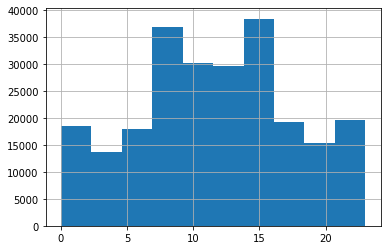

In [ ]:
hn_historic_data.time.dt.tz_localize("UTC").dt.tz_convert(timezone).dt.hour.hist()

How many daily posts do we have?

In [ ]:
ts = hn_historic_data[['time', 'score']].set_index('time').sort_index().rolling('1d')

print(f"Start date: {hn_historic_data['time'].min()}, End date: {hn_historic_data['time'].max()}")
print(f"Total posts: {hn_historic_data.shape[0]}")
print(f"Comments per post: {hn_historic_data.kids.apply(lambda x: len(x)).median()}")
print(f"Median daily posts: {ts.count().median()[0]}, max post count: {ts.count().max()[0]}")
print(f"Min score: {hn_historic_data['score'].min()}. Max score: {hn_historic_data['score'].max()}")

Start date: 2015-08-03 21:52:38, End date: 2020-11-16 02:12:45
Total posts: 239621
Comments per post: 6.0
Median daily posts: 133.0, max post count: 231.0
Min score: 1.0. Max score: 6015.0


## Topic modelling
We will evaluate 2 topic modelling algoritms:
* [Latent Dirichlet Allocation](https://en.wikipedia.org/wiki/Latent_Dirichlet_allocation)
* [Top2Vec](https://github.com/ddangelov/Top2Vec) (deep learning based approach that clusters BERT embeddings)

In the end, Top2Vec model showed more diverse set of topics, so that is the main approach that I have chosen to analyze the dataset.

### LDA Pipeline

In [ ]:
import nltk
import gensim
from nltk.tokenize import RegexpTokenizer
from nltk.corpus import stopwords
from nltk.stem.wordnet import WordNetLemmatizer
from gensim.models import Phrases
from gensim.corpora import Dictionary
from gensim.models import LdaModel
from gensim.models.wrappers import LdaMallet
from gensim.models import CoherenceModel
from pprint import pprint
from wordcloud import WordCloud
from matplotlib import pyplot as plt
from tqdm.notebook import tqdm
from typing import List, Tuple, Dict, Union, Optional

#import pyLDAvis.gensim
#pyLDAvis.enable_notebook()

pd.options.display.max_colwidth = 100

nltk.download('wordnet')
nltk.download('stopwords')

stop_words = set(stopwords.words("english"))

def get_corpus(data: pd.DataFrame, cls: Optional[int]):
    """Get corpus for given class. Filters HN tags from texts to avoid bias in topic model"""
    titles = data[['title', 'score_class']]
    if cls is not None:
        titles = data[data['score_class'].cat.codes == cls]
    titles = titles['title']
    titles = titles.str.replace(r"^\w+\sHN\s?:\s?", "", regex=True)
    # titles = titles.str.replace("Ask HN: ", "")
    # titles = titles.str.replace("Tell HN: ", "")
    # titles = titles.str.replace("Launch HN: ", "")
    return titles.dropna()

def tokenize(docs: List[str]) -> List[List[str]]:
  """Split the documents into tokens"""
  tokenizer = RegexpTokenizer(r'\w+')
  for idx in range(len(docs)):
      docs[idx] = docs[idx].lower()  # Convert to lowercase.
      docs[idx] = tokenizer.tokenize(docs[idx])  # Split into words.
  return docs

def filter_token(token: str) -> bool:
  """
  Remove numbers, but not words that contain numbers
  Remove words that are only one character
  Remove stopwords
  """
  return not token.isnumeric() and len(token) > 1 and not token in stop_words

def preprocess_docs(docs: List[List[str]]) -> List[List[str]]:
    """Filter and lemmatize all input tokens"""
    lemmatizer = WordNetLemmatizer()
    processed_docs = []

    for doc in docs:
        processed_docs.append([])
        for token in doc:
            if filter_token(token):
                lemmatized = lemmatizer.lemmatize(token)
                processed_docs[-1].append(lemmatized)

    return processed_docs

def compute_bigrams(processed_docs: List[List[str]]) -> List[List[str]]:
    """ Add bigrams and trigrams to docs (only ones that appear 20 times or more)"""
    bigram = Phrases(processed_docs, min_count=20)
    for idx in range(len(processed_docs)):
        for token in bigram[processed_docs[idx]]:
            if '_' in token:
                # Token is a bigram, add to document.
                processed_docs[idx].append(token)
    return processed_docs

def create_dictionary(processed_docs: List[List[str]], no_below: int = 20, no_above: int = 0.35) -> Tuple[List[List[int]], Dictionary]:
    """Creates gensim dictionary and corpus list with token ids"""
    # Create a dictionary representation of the documents.
    dictionary = Dictionary(processed_docs)

    # Filter out words that occur less than 20 documents, or more than 35% of the documents.
    dictionary.filter_extremes(no_below=no_below, no_above=no_above)

    # Bag-of-words representation of the documents.
    corpus = [dictionary.doc2bow(doc) for doc in processed_docs]
    print('Number of unique tokens: %d' % len(dictionary))
    print('Number of documents: %d' % len(corpus))
    temp = dictionary[0]  # This is only to "load" the dictionary.

    return corpus, dictionary

def train_lda(corpus: List[List[int]], id2token: Dict[int, str], num_topics: int = 10, model: str = 'gensim') -> LdaModel:
    # Set training parameters.

    chunksize = 2000
    passes = 20
    iterations = 400
    eval_every = None  # Don't evaluate model perplexity, takes too much time.

    if model == 'gensim':
        model = LdaModel(
            corpus=corpus,
            id2word=id2token,
            chunksize=chunksize,
            alpha='auto',
            eta='auto',
            iterations=iterations,
            num_topics=num_topics,
            passes=passes,
            eval_every=eval_every
        )
    elif model == 'mallet':
        model = LdaMallet(
            './mallet-2.0.8/bin/mallet', 
            corpus=corpus,
            id2word=id2token,
            num_topics=num_topics)
        model = gensim.models.wrappers.ldamallet.malletmodel2ldamodel(model)
    else:
        raise ValueError("Invalid LDA model type")

    return model

def prepare_corpus(hn_historic_data: pd.DataFrame, class_id: int, no_below: int = 20, no_above: int = 0.35) -> Tuple[List[List[str]], List[List[int]], Dictionary]:
    """Data preparation pipeline"""
    docs = get_corpus(hn_historic_data, class_id).tolist()
    docs = tokenize(docs)
    processed_docs = preprocess_docs(docs)
    processed_docs = compute_bigrams(processed_docs)
    corpus, dictionary = create_dictionary(processed_docs, no_below=no_below, no_above=no_above)

    return docs, corpus, dictionary

def train_lda_for_class(hn_historic_data: pd.DataFrame, class_id: int, num_topics: int = 10, no_below: int = 20, no_above: float = 0.35, model: str = 'gensim'):
    """Trains LDA model for given class"""
    _, corpus, dictionary = prepare_corpus(hn_historic_data, class_id)
    model = train_lda(corpus, dictionary.id2token, model=model, num_topics=num_topics)
    return model, corpus, dictionary

def search_n_topics(hn_historic_data: pd.DataFrame, class_id: int, limit: int, start: int = 2, step: int = 3, model: str = 'mallet') -> Tuple[List[LdaModel], List[float]]:
    """
    Compute c_v coherence for various number of topics

    Parameters:
    ----------
    hn_historic_data: dataset
    class_id: class id
    limit : Max num of topics

    Returns:
    -------
    model_list : List of LDA topic models
    coherence_values : Coherence values corresponding to the LDA model with respective number of topics
    """
    docs, corpus, dictionary = prepare_corpus(hn_historic_data, class_id)
    
    coherence_values = []
    model_list = []

    chunksize = 2000
    passes = 20
    iterations = 400
    eval_every = None  # Don't evaluate model perplexity, takes too much time.

    for num_topics in tqdm(range(start, limit, step), total=limit // step):
        model = train_lda(corpus, dictionary.id2token, num_topics=num_topics)
        model_list.append(model)
        coherencemodel = CoherenceModel(model=model, texts=docs, corpus=corpus, coherence='u_mass')
        coherence = coherencemodel.get_coherence()
        coherence_values.append(coherence)
        print(f"Coherence for {num_topics} is {coherence}")

    # Show graph
    x = range(start, limit, step)
    plt.plot(x, coherence_values)
    plt.xlabel("Num Topics")
    plt.ylabel("Coherence score")
    plt.legend(("coherence_values"), loc='best')
    plt.show()

    return model_list, coherence_values


def print_topics(model: LdaModel, corpus: List[List[int]], num_topics: int = 10):
    top_topics = model.top_topics(corpus) #, num_words=20)
    
    # Average topic coherence is the sum of topic coherences of all topics, divided by the number of topics.
    avg_topic_coherence = sum([t[1] for t in top_topics]) / num_topics
    print('Average topic coherence: %.4f.' % avg_topic_coherence)
    pprint(top_topics)

def render_wordclouds(model: LdaModel, corpus: List[List[int]], figsize=(10, 45)):
    """Create wordclouds from gemsim topic model"""
    topics = model.top_topics(corpus)

    fig, ax = plt.subplots(len(topics), 1, figsize=figsize)

    for i, topic in enumerate(topics):
        topic = { w: f  for f, w in topic[0] }
        wc = WordCloud(background_color="white")
        wc.generate_from_frequencies(topic)
        ax[i].imshow(wc, interpolation="bilinear")
        ax[i].axis("off")

def format_topics_sentences(model: LdaModel, corpus: List[List[int]], texts: List[List[str]]) -> pd.DataFrame:
    """Creata a dataframe with topics and keywords for all sentences in texts"""
    # Init output
    sent_topics_df = pd.DataFrame()

    # Get main topic in each document
    for i, row in tqdm(enumerate(model[corpus]), total=len(model[corpus])):
        row = sorted(row, key=lambda x: (x[1]), reverse=True)
        # Get the Dominant topic, Perc Contribution and Keywords for each document
        for j, (topic_num, prop_topic) in enumerate(row):
            if j == 0:  # => dominant topic
                wp = model.show_topic(topic_num)
                topic_keywords = ", ".join([word for word, prop in wp])
                sent_topics_df = sent_topics_df.append(pd.Series([int(topic_num), round(prop_topic,4), topic_keywords]), ignore_index=True)
            else:
                break
    sent_topics_df.columns = ['Dominant_Topic', 'Perc_Contribution', 'Topic_Keywords']

    # Add original text to the end of the output
    contents = pd.Series(texts)
    sent_topics_df = pd.concat([sent_topics_df, contents], axis=1)
    return sent_topics_df

def most_representative_documents(df_topic_sents_keywords: pd.DataFrame, n_sentences: int = 1) -> pd.DataFrame:
    """Find most representative documents for each topic"""
    # Group top 5 sentences under each topic
    sent_topics_sorteddf_mallet = pd.DataFrame()

    sent_topics_outdf_grpd = df_topic_sents_keywords.groupby('Dominant_Topic')

    for i, grp in tqdm(sent_topics_outdf_grpd):
        sent_topics_sorteddf_mallet = pd.concat([sent_topics_sorteddf_mallet, 
                                                grp.sort_values(['Perc_Contribution'], ascending=[0]).head(n_sentences)], 
                                                axis=0)

    # Format    
    sent_topics_sorteddf_mallet.reset_index(drop=True, inplace=True)
    sent_topics_sorteddf_mallet.columns = ['Topic_Num', "Topic_Perc_Contrib", "Keywords", "Text"]

    return sent_topics_sorteddf_mallet

def explain_topics(data: pd.DataFrame, class_id: int, model: str = 'mallet') -> Tuple[LdaModel, "vis", pd.DataFrame]:
    """Train LDA model for given class and return visualization and representative docs for model interpretation"""
    print(f"Training model for class {class_id}")
    model, corpus, dictionary = train_lda_for_class(data, class_id, num_topics=4, no_below=20, no_above=0.5, model=model)
    print("Searching for top sentences")
    df_topic_sents_keywords = format_topics_sentences(model, corpus, get_corpus(data, class_id).tolist())
    representative_docs = most_representative_documents(df_topic_sents_keywords, n_sentences=5)
    print("Creating visualization")
    vis = pyLDAvis.gensim.prepare(model, corpus, dictionary)

    return model, vis, corpus, representative_docs

[nltk_data] Downloading package wordnet to /root/nltk_data...
[nltk_data]   Unzipping corpora/wordnet.zip.
[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.


In [ ]:
models_0, coherence_0 = search_n_topics(hn_historic_data, 0, 10, 2, 1)

Number of unique tokens: 2925
Number of documents: 62116


Number of unique tokens: 4955
Number of documents: 108846


Coherence for 2 is -5.010836007044679
Coherence for 3 is -5.43561384110042
Coherence for 4 is -5.946795798012504
Coherence for 5 is -6.9931308689842355
Coherence for 6 is -6.3460948738727625
Coherence for 7 is -6.906959869002336
Coherence for 8 is -6.676451868966735
Coherence for 9 is -7.496834465381355



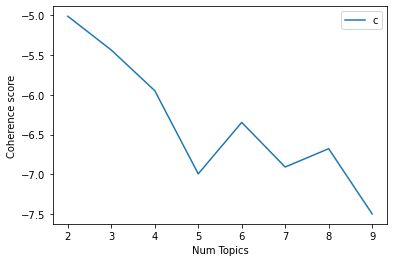

In [ ]:
models_1, coherence_1 = search_n_topics(hn_historic_data, 1, 10, 2, 1)

Number of unique tokens: 3383
Number of documents: 67619


Coherence for 2 is -5.277658245076145
Coherence for 3 is -5.667897452935416
Coherence for 4 is -6.781406007549234
Coherence for 5 is -7.499870447075486
Coherence for 6 is -7.373097333154221
Coherence for 7 is -8.288805035751013
Coherence for 8 is -8.521737341990814
Coherence for 9 is -8.680310465815815



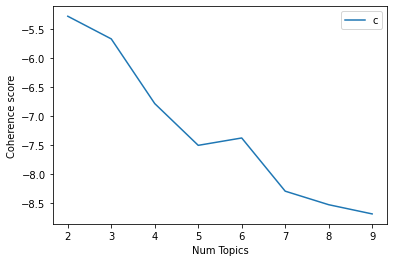

In [ ]:
models_2, coherence_2 = search_n_topics(hn_historic_data, 2, 10, 2, 1)

### Top2Vec

In [ ]:
!pip install -U numba
!pip install -U joblib

Requirement already up-to-date: numba in /usr/local/lib/python3.6/dist-packages (0.52.0)
     |████████████████████████████████| 307kB 15.9MB/s 
ERROR: top2vec 1.0.20 has requirement joblib<1.0.0, but you'll have joblib 1.0.0 which is incompatible.
  Found existing installation: joblib 0.17.0
    Uninstalling joblib-0.17.0:
      Successfully uninstalled joblib-0.17.0


In [ ]:
from top2vec import Top2Vec
from typing import Tuple
import pandas as pd

def train_top2vec(data: pd.DataFrame, class_id: int, n_topics: int = 4) -> Tuple[Top2Vec, pd.Series]:
    docs = get_corpus(data, class_id)
    model = Top2Vec(docs.tolist(), embedding_model='distiluse-base-multilingual-cased', document_ids=docs.index.tolist())
    model.hierarchical_topic_reduction(n_topics)
    return model, docs

def explain_top2vec(model: Top2Vec, num_docs=50):
    for topic_id in range(0, model.get_num_topics(reduced=True)):
        documents, document_scores, document_ids = model.search_documents_by_topic(topic_num=topic_id, num_docs=num_docs, reduced=True)
        print(f"{'[Topic ' + str(topic_id) + ']':=^120}")
        model.generate_topic_wordcloud(topic_id, reduced=True)

        for doc, score, doc_id in zip(documents, document_scores, document_ids):
            print(f"Document {doc_id:<10} Score {score:<10.2f} {doc:<120}")

In [ ]:
top2vec_models = {}

for class_id in tqdm(hn_historic_data['score_class'].cat.codes.unique()):
    if class_id >= 0:
        print(f"Training model for class {class_id}")
        model = train_top2vec(hn_historic_data, class_id)
        top2vec_models[class_id] = model

## Topic analysis

### Top2Vec

We can try to extract and analyze topics in two ways:
1. Train Top2Vec on whole dataset and compare topic distributions among different score classes
2. Train separate Top2Vec models for each score class

First approach showed better results with clearly diffferent topic distributions among selected score ranges. The second approach suffers from class imbalance problem: there is not much data to train on in higher score ranges. Another con of the second approach is that lost of topics overlab between score ranges. Lots of manual analysis needs to be done as a result. 

#### Global model

In this section we will train a global model for all score classes with 10 and 15 topics

In [ ]:
global_top2vec, global_corpus = train_top2vec(hn_historic_data, None, n_topics=10)

2021-01-30 15:50:22,394 - top2vec - INFO - Pre-processing documents for training
2021-01-30 15:50:30,897 - top2vec - INFO - Downloading distiluse-base-multilingual-cased model
100%|██████████| 504M/504M [00:53<00:00, 9.37MB/s]
2021-01-30 15:51:37,021 - top2vec - INFO - Creating joint document/word embedding
2021-01-30 17:37:27,796 - top2vec - INFO - Creating lower dimension embedding of documents
2021-01-30 17:46:12,977 - top2vec - INFO - Finding dense areas of documents
/usr/local/lib/python3.6/dist-packages/joblib/parallel.py:325: DeprecationWarning: check_pickle is deprecated in joblib 0.12 and will be removed in 0.13
  return function, args, kwargs
/usr/local/lib/python3.6/dist-packages/joblib/parallel.py:325: DeprecationWarning: check_pickle is deprecated in joblib 0.12 and will be removed in 0.13
  return function, args, kwargs
/usr/local/lib/python3.6/dist-packages/joblib/parallel.py:325: DeprecationWarning: check_pickle is deprecated in joblib 0.12 and will be removed in 0.13
 

In [ ]:
global_top2vec.save("global_top2vec_10_topic")

**10 topic model**. Topics were named manually by analyzing most relevant titles in each topic cluster

1. Breakthrough news, big news
2. Leaks, haks, money steals
3. New tech annoucements, methodology discussions
4. "How to" posts
5. Cryptocurrency
6. 2-3 word titles. Mainly tech releases
7. Programming language & coding tutorials
8. How/What titles about funding, projects and startups
9. Jobs, economics
10. Apple news

=======================================================[Topic 0]========================================================
Document 8115       Score 0.64       Volkswagen Reaches Deal in U.S. Over Emissions Scandal                                                                  
Document 108847     Score 0.63       Epidemiologists Stray from the Covid Herd                                                                               
Document 218530     Score 0.63       NTSB sending investigators to fatal Tesla-semitrailer crash                                                             
Document 229844     Score 0.63       Yale scientists make a borophene breakthrough                                                                           
Document 184699     Score 0.63       ‘Earthworm Dilemma’ Has Climate Scientists Racing to Keep Up                                                            
Document 50227      Score 0.62       'Pandemic' scientist makes breakthrough on Covid-19 

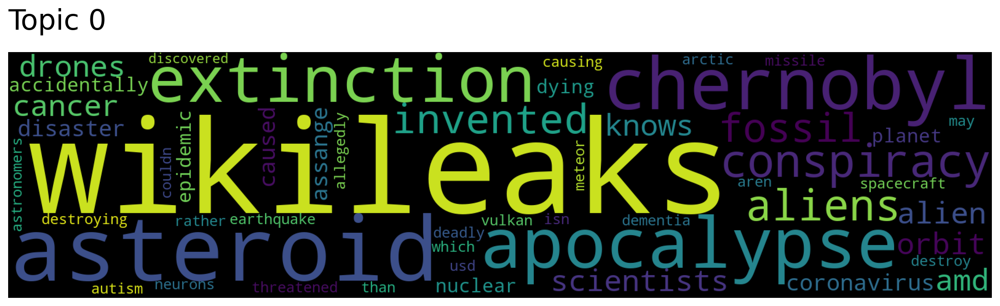

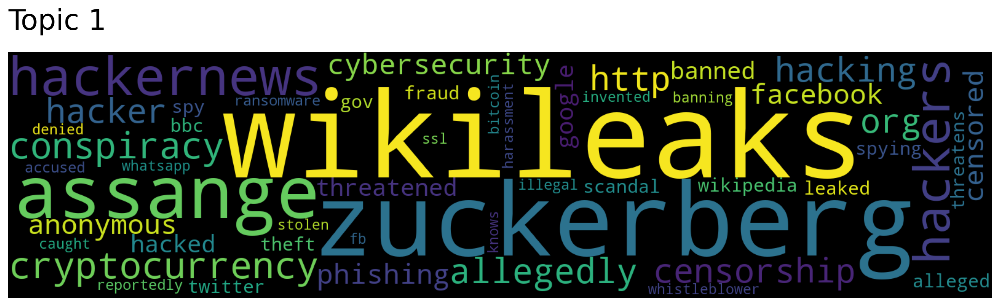

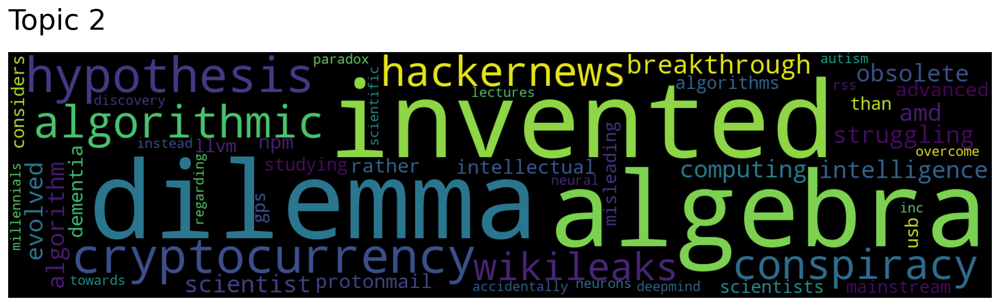

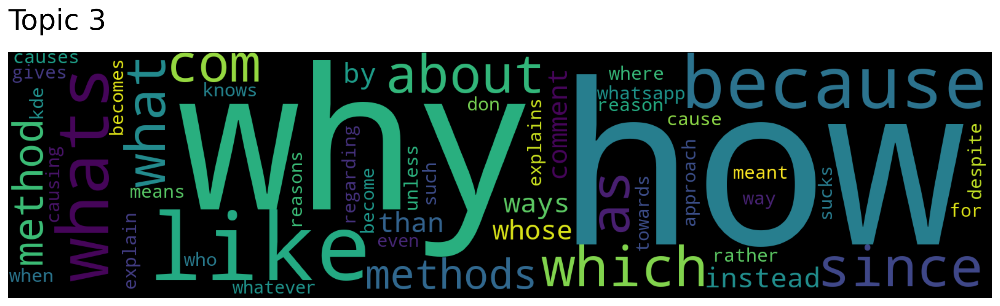

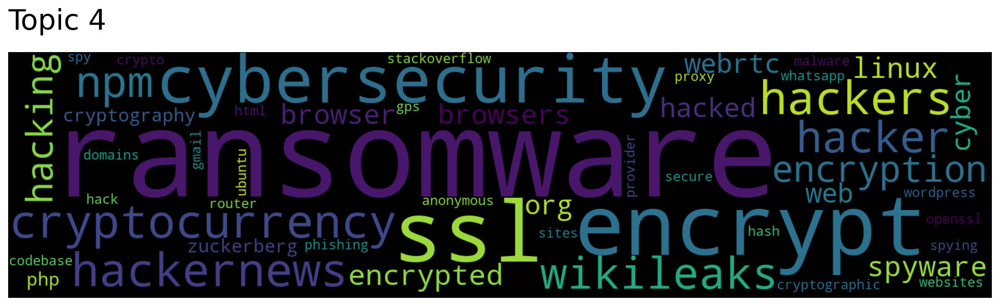

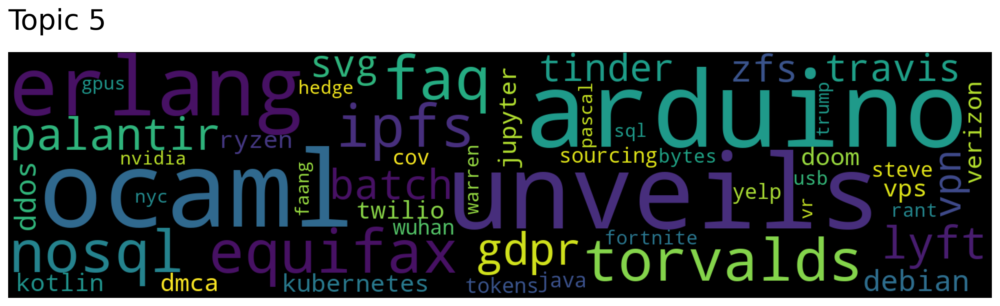

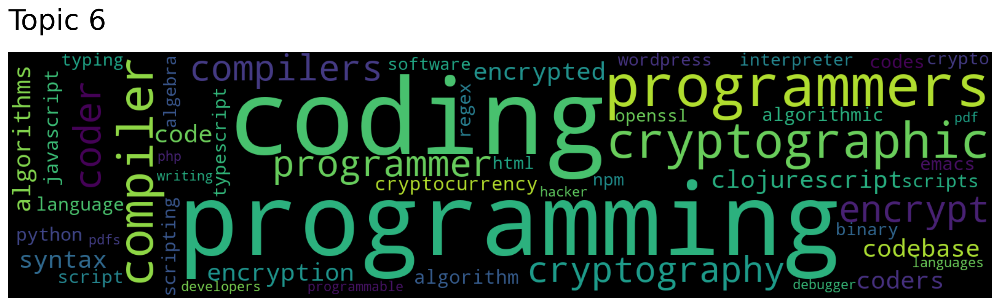

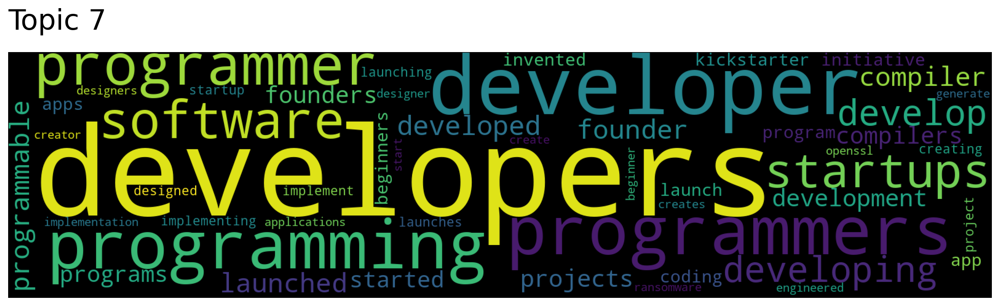

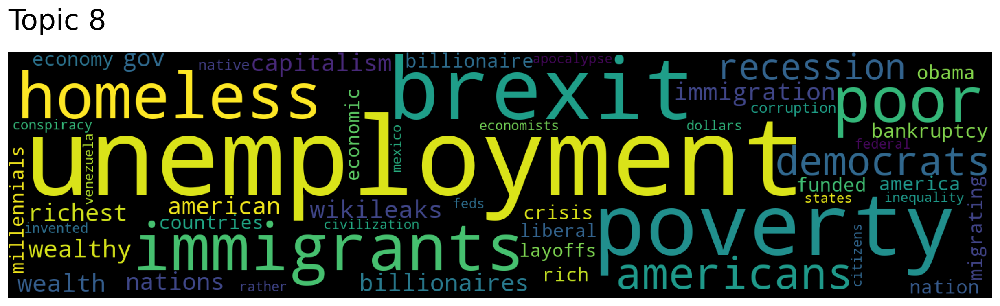

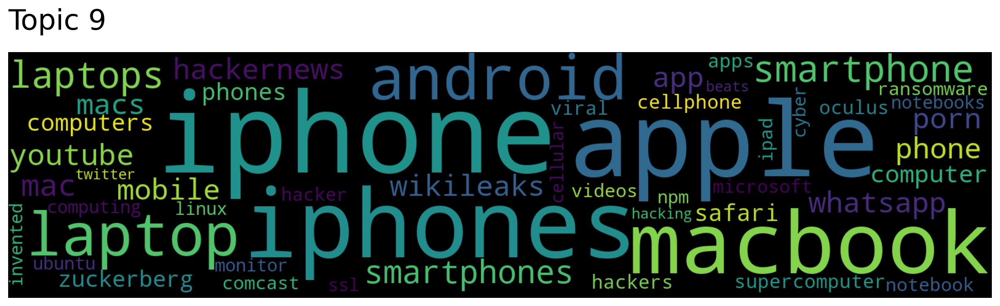

In [ ]:
explain_top2vec(global_top2vec)

In [ ]:
from typing import Optional, List

def get_topics_df(data: pd.DataFrame, corpus: pd.Series, model: Top2Vec, topic_names: Optional[List]) -> pd.DataFrame:
    topics = model.get_documents_topics(corpus.index.tolist(), reduced=True)

    topics_df = pd.concat([corpus, data.score_class, data.score], axis=1, join='inner')

    topic_info = pd.DataFrame({'topic': pd.Series(topics[0]), 
                'prob': pd.Series(topics[1]),
                'keywords': [", ".join(kw) for kw in topics[2]]})
    topic_info.topic = pd.Categorical.from_codes(topic_info.topic.tolist(), 
                                                 categories=topic_names, ordered=False)
    topics_df = pd.concat([topics_df.reset_index(drop=True), topic_info.reset_index(drop=True)], axis=1)
    return topics_df

In [ ]:
topics_df = get_topics_df(hn_historic_data, 
                          global_corpus, 
                          global_top2vec, 
                          ["Breakthrough news, big news", 
                           "Leaks, haks, money steals", 
                           "New tech annoucements, methodology discussions", 
                           "How to posts", "Cryptocurrency", 
                           "2-3 word titles. Mainly tech releases", 
                           "Programming language & coding tutorials", 
                           "How/What titles about funding, projects and startups", 
                           "Jobs, economics", 
                           "Apple news"])

NameError: ignored

**15 topic model**. Topics were named manually by analyzing most relevant titles in each topic cluster

1. "How to" posts
1. New product or feature announcements, advanced tutorials
1. 2-3 word titles. Mainly tech releases
1. Negative news about large tech companies, lawsuits
1. Politics
1. Salary, job change, layoffs
1. Programming language & coding tutorials 
1. Science news
1. Security
1. CEO/billionaire news
1. Tech history
1. COVID
1. Software engineers hard&soft skills, learning materials
1. How tech&AI influences our lives?
1. Apple news

In [ ]:
global_top2vec_15, global_corpus_15 = train_top2vec(hn_historic_data, None, n_topics=15)
global_top2vec_15.save("global_top2vec_15_topic_2")

2021-02-01 12:39:35,384 - top2vec - INFO - Pre-processing documents for training
2021-02-01 12:39:41,874 - top2vec - INFO - Downloading distiluse-base-multilingual-cased model
100%|██████████| 504M/504M [00:17<00:00, 28.7MB/s]
2021-02-01 12:40:07,791 - top2vec - INFO - Creating joint document/word embedding
2021-02-01 12:42:29,204 - top2vec - INFO - Creating lower dimension embedding of documents
2021-02-01 12:48:46,330 - top2vec - INFO - Finding dense areas of documents


TypeError: ignored

In [ ]:
global_top2vec_15 = Top2Vec.load("global_top2vec_15_topic")

In [ ]:
global_corpus_15 = pd.read_csv("global_corpus_15.csv")
global_corpus_15 = global_corpus_15.set_index('Unnamed: 0')

=======================================================[Topic 0]========================================================
Document 25346      Score 0.69       How does HN earn money to keep going?                                                                                   
Document 207164     Score 0.68       How do I build upon what HN did for OldGeekJobs.com?                                                                    
Document 109752     Score 0.68       How does WhatRuns.com make money?                                                                                       
Document 22654      Score 0.68       How have you dealt with workaholism?                                                                                    
Document 72067      Score 0.68       How to segfault bash: a() { a; }; a                                                                                     
Document 237877     Score 0.67       How do you earn a living from scraping in 2018?     

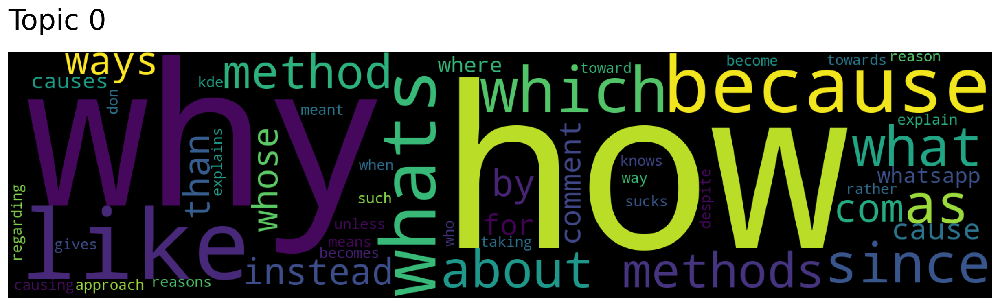

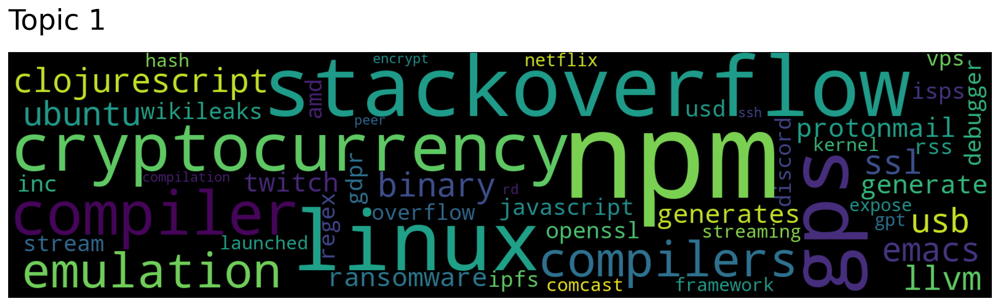

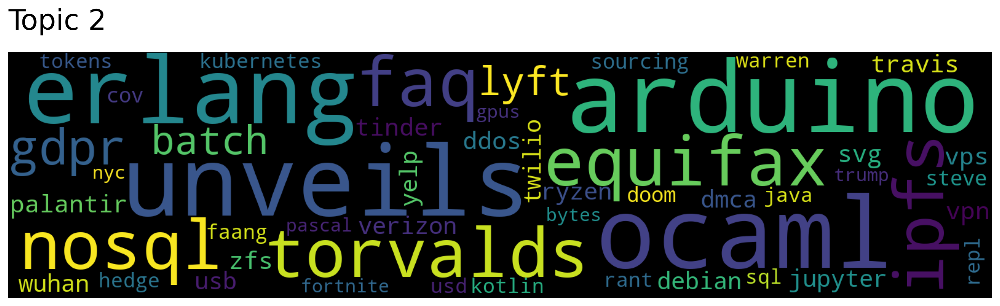

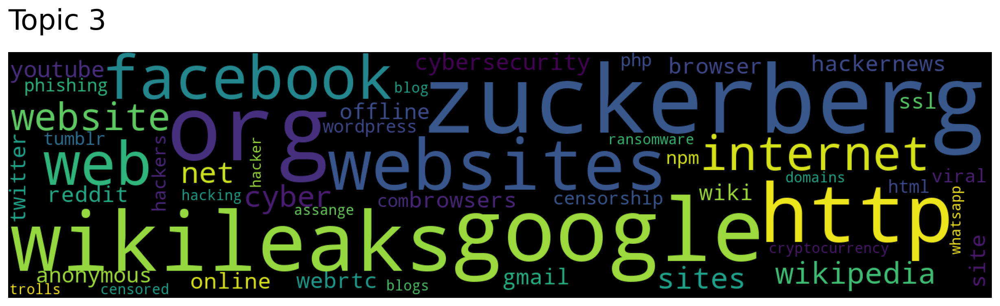

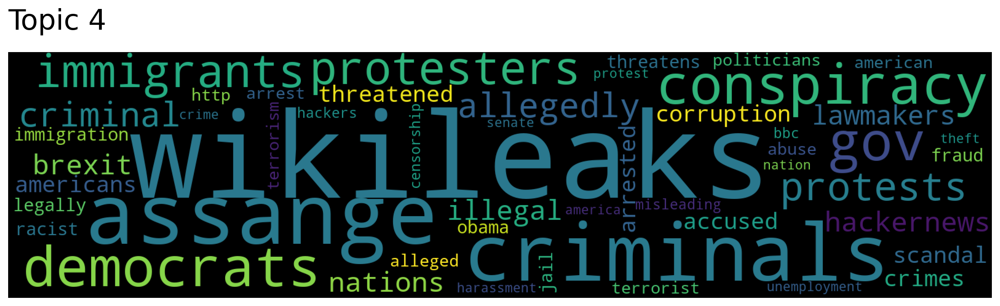

...

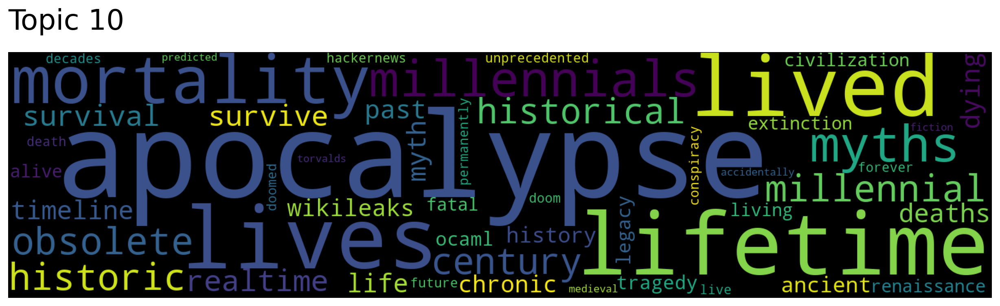

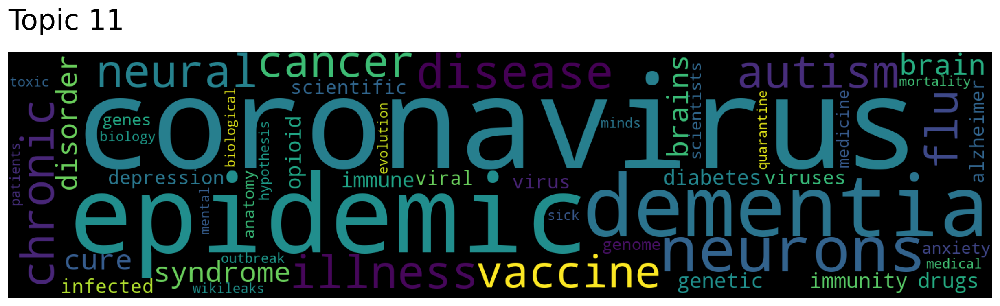

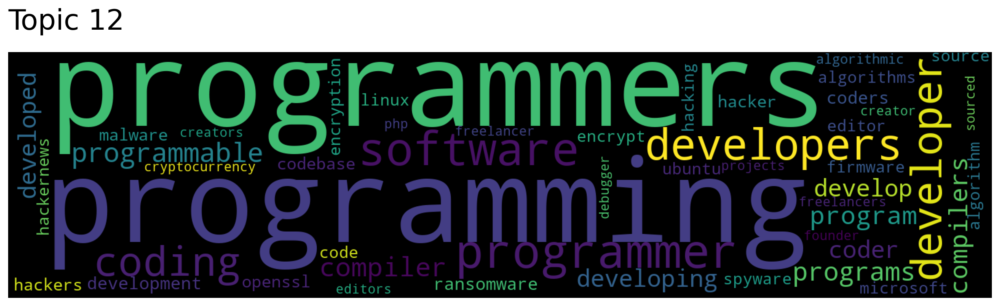

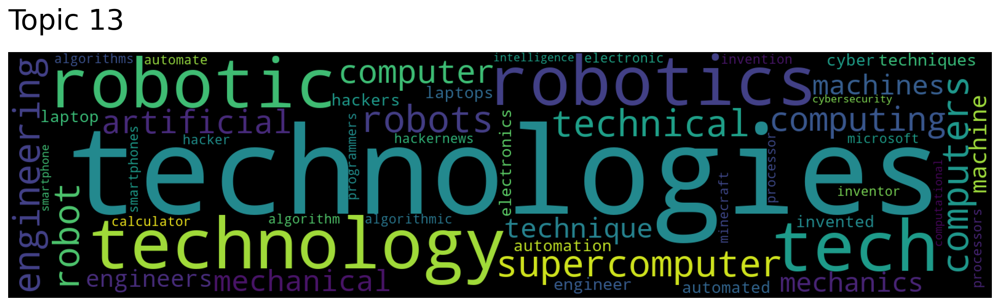

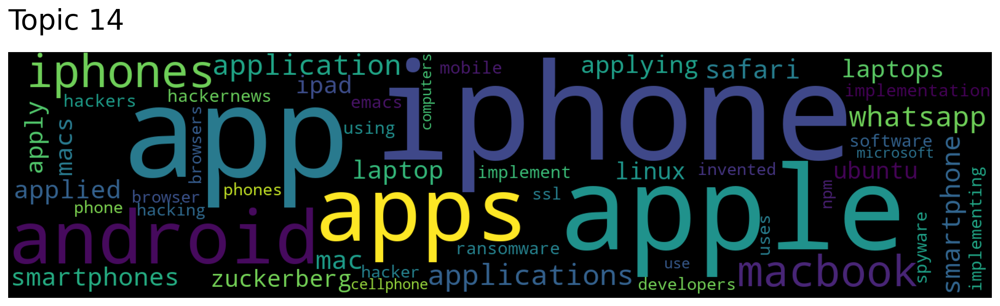

In [ ]:
explain_top2vec(global_top2vec_15, num_docs=150)

In [ ]:
global_corpus_15.to_csv('global_corpus_15.csv')

In [ ]:
topics_df = get_topics_df(hn_historic_data, 
                          global_corpus_15, 
                          global_top2vec_15, 
                          ["How to posts", 
                           "New product or feature announcements, advanced tutorials",
                           "2-3 word titles. Mainly tech releases", 
                           "Negative news about large tech companies, lawsuits", 
                           "Politics", 
                           "Salary, job change, layoffs", 
                           "Programming language & coding tutorials", 
                           "Science news", 
                           "Security", 
                           "CEO/billionaire news",
                           "Tech history",
                           "COVID",
                           "Software engineer hard&soft skills, learning materials",
                           "AI, Robotics",
                           "Apple news"])

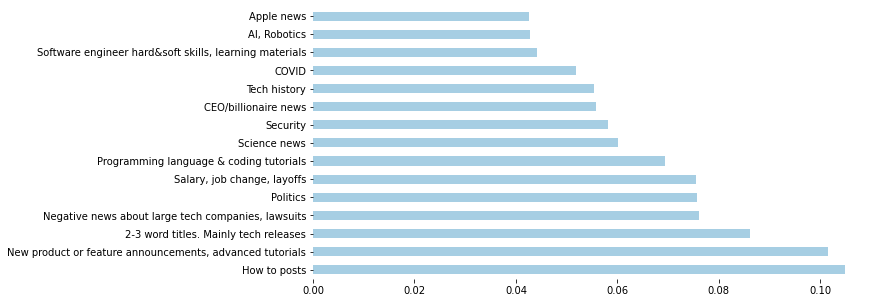

In [ ]:
total_counts = topics_df.topic.value_counts(normalize=True)
ax = total_counts.plot(kind='barh', figsize=(10, 5), colormap="Paired")
remove_borders(ax)
ax

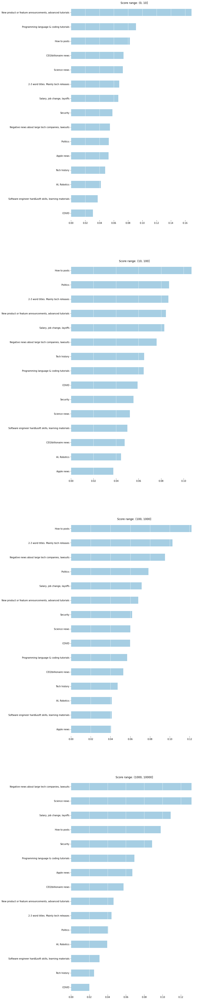

In [ ]:
total_counts = topics_df.topic.value_counts(normalize=True)

groups = list(topics_df.groupby('score_class'))
fig, ax = plt.subplots(len(groups), 1, sharex=False, figsize=(10, 80))

for i, grp in enumerate(groups):
    counts = grp[1].topic.value_counts(normalize=True)
    remove_borders(ax[i])
    counts.sort_values(ascending=True).plot(kind='barh', ax=ax[i], title="Score range: " + str(grp[0]), colormap="Paired")
    ax[i].grid(color='white', axis='x')

#### Topic regression models

Processing topic 'Tech history'
Processing topic 'CEO/billionaire news'
Processing topic 'Science news'
Processing topic 'New product or feature announcements, advanced tutorials'
Processing topic 'Negative news about large tech companies, lawsuits'
Processing topic 'Salary, job change, layoffs'
Processing topic 'AI, Robotics'
Processing topic 'How to posts'
Processing topic 'Politics'
Processing topic '2-3 word titles. Mainly tech releases'
Processing topic 'Software engineer hard&soft skills, learning materials'
Processing topic 'Programming language & coding tutorials'
Processing topic 'Apple news'
Processing topic 'Security'
Processing topic 'COVID'


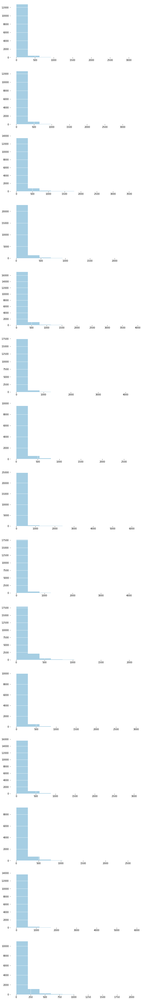

In [ ]:
groups = list(topics_df.topic.unique())
fig, ax = plt.subplots(len(groups), 1, sharex=False, figsize=(10, 80))

for i, grp in enumerate(groups):
    print(f"Processing topic '{grp}'")
    remove_borders(ax[i])
    topic_df = topics_df[topics_df.topic == grp]
    ax[i].grid(color='white', axis='both')
    topic_df.score.hist(ax=ax[i])

In [ ]:
!pip install -U pymc3[plots]

In [ ]:
import pickle

def save_model(trace, network):
    with open ('pymc_model.pkl', 'wb') as buff:
        pickle.dump ({'model': network, 'trace': trace}, buff)

def load_model():
    with open ('pymc_model.pkl', 'rb') as buff:
        data = pickle.load(buff)
        network, trace = data['model'], data['trace']
    return network, trace

In [ ]:
import pymc3 as pm

topic_score_model = pm.Model()
n_topics = 15
batch_size = 512

cat_data = pm.Minibatch(topics_df.topic.cat.codes, batch_size=batch_size)

with topic_score_model:
    topic_p = pm.Dirichlet('topic_p', np.ones(n_topics))
    topic = pm.Categorical('topic', topic_p, observed=topics_df.topic.cat.codes)

    score_alpha = pm.Dirichlet('score_alpha', np.ones(n_topics))

    scores = []
    for i in range(0, n_topics):
        topic_name = topics_df.topic.cat.categories[i]
        score_data = topics_df[topics_df.topic.cat.codes == i].score.tolist()
        print(f"Adding topic distribution for '{topic_name}' with {len(score_data)} observed data points")
        score_data = pm.Minibatch(score_data, batch_size=batch_size)
        score_dist = pm.Poisson(f'score_dist_{i}', score_alpha[i], observed=score_data)
        scores.append(score_dist)

    # step = pm.Metropolis()
    # trace = pm.sample(10000, tune=5000, step=step)
    advi_fit = pm.fit(method=pm.ADVI(), n=30000)

/usr/local/lib/python3.6/dist-packages/_pytest/mark/structures.py:426: DeprecationWarning: The usage of `cmp` is deprecated and will be removed on or after 2021-06-01.  Please use `eq` and `order` instead.
  @attr.s(cmp=False, hash=False)
/usr/local/lib/python3.6/dist-packages/pymc3/data.py:307: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  self.shared = theano.shared(data[in_memory_slc])
/usr/local/lib/python3.6/dist-packages/pymc3/distributions/multivariate.py:462: DeprecationWarning: Shape not explicitly set. Please, set the value using the `shape` keyword argument. Using the test value to infer the shape.
  DeprecationWarning,
/usr/local/lib/python3.6/dist-packages/pymc3/distributions/multivariate.py:462: DeprecationWarning: Shape not explicitly set. Please,

Adding topic distribution for 'How to posts' with 31508 observed data points


/usr/local/lib/python3.6/dist-packages/pymc3/data.py:307: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  self.shared = theano.shared(data[in_memory_slc])


Adding topic distribution for 'New product or feature announcements, advanced tutorials' with 24721 observed data points
Adding topic distribution for '2-3 word titles. Mainly tech releases' with 24543 observed data points


/usr/local/lib/python3.6/dist-packages/pymc3/data.py:307: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  self.shared = theano.shared(data[in_memory_slc])
/usr/local/lib/python3.6/dist-packages/pymc3/data.py:307: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  self.shared = theano.shared(data[in_memory_slc])


Adding topic distribution for 'Negative news about large tech companies, lawsuits' with 19475 observed data points
Adding topic distribution for 'Politics' with 16671 observed data points


/usr/local/lib/python3.6/dist-packages/pymc3/data.py:307: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  self.shared = theano.shared(data[in_memory_slc])
/usr/local/lib/python3.6/dist-packages/pymc3/data.py:307: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  self.shared = theano.shared(data[in_memory_slc])


Adding topic distribution for 'Salary, job change, layoffs' with 14810 observed data points
Adding topic distribution for 'Programming language & coding tutorials' with 14711 observed data points


/usr/local/lib/python3.6/dist-packages/pymc3/data.py:307: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  self.shared = theano.shared(data[in_memory_slc])
/usr/local/lib/python3.6/dist-packages/pymc3/data.py:307: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  self.shared = theano.shared(data[in_memory_slc])


Adding topic distribution for 'Science news' with 14117 observed data points
Adding topic distribution for 'Security' with 13993 observed data points


/usr/local/lib/python3.6/dist-packages/pymc3/data.py:307: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  self.shared = theano.shared(data[in_memory_slc])
/usr/local/lib/python3.6/dist-packages/pymc3/data.py:307: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  self.shared = theano.shared(data[in_memory_slc])


Adding topic distribution for 'CEO/billionaire news' with 12927 observed data points
Adding topic distribution for 'Tech history' with 11689 observed data points


/usr/local/lib/python3.6/dist-packages/pymc3/data.py:307: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  self.shared = theano.shared(data[in_memory_slc])
/usr/local/lib/python3.6/dist-packages/pymc3/data.py:307: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  self.shared = theano.shared(data[in_memory_slc])


Adding topic distribution for 'COVID' with 10986 observed data points
Adding topic distribution for 'Software engineer hard&soft skills, learning materials' with 10366 observed data points


/usr/local/lib/python3.6/dist-packages/pymc3/data.py:307: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  self.shared = theano.shared(data[in_memory_slc])
/usr/local/lib/python3.6/dist-packages/pymc3/data.py:307: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  self.shared = theano.shared(data[in_memory_slc])


Adding topic distribution for 'AI, Robotics' with 9670 observed data points
Adding topic distribution for 'Apple news' with 9230 observed data points


/usr/local/lib/python3.6/dist-packages/pymc3/data.py:307: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  self.shared = theano.shared(data[in_memory_slc])
/usr/local/lib/python3.6/dist-packages/pymc3/data.py:307: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  self.shared = theano.shared(data[in_memory_slc])


Finished [100%]: Average Loss = 5.7117e+06


In [ ]:
trace = advi_fit.sample(10000)
save_model(trace, topic_score_model)

NameError: ignored

In [ ]:
import pymc3 as pm

model, trace = load_model()

In [ ]:
model

NameError: ignored

In [ ]:
pm.plot_posterior(trace['score_dist_New product or feature announcements, advanced tutorial'])

KeyError: ignored

In [ ]:
pm.plot_posterior(trace)

/usr/local/lib/python3.6/dist-packages/arviz/data/io_pymc3.py:92: FutureWarning: Using `from_pymc3` without the model will be deprecated in a future release. Not using the model will return less accurate and less useful results. Make sure you use the model argument or call from_pymc3 within a model context.
  FutureWarning,


#### 1 model per score class

=======================================================[Topic 0]========================================================
Document 33283      Score 0.65       WeRead – Hacker News for non-geeks                                                                                      
Document 43655      Score 0.63       Devuan Taken Down by “Gopher” Hackers                                                                                   
Document 15609      Score 0.63       Tesla saboteur claims to be whistleblower                                                                               
Document 29609      Score 0.62       TD Ameritrade Acquiring Schwab Nightmare                                                                                
Document 41767      Score 0.61       Acting AG Fired for “Betraying” the DOJ                                                                                 
Document 12038      Score 0.60       Kickass Torrents seized, founder arrested           

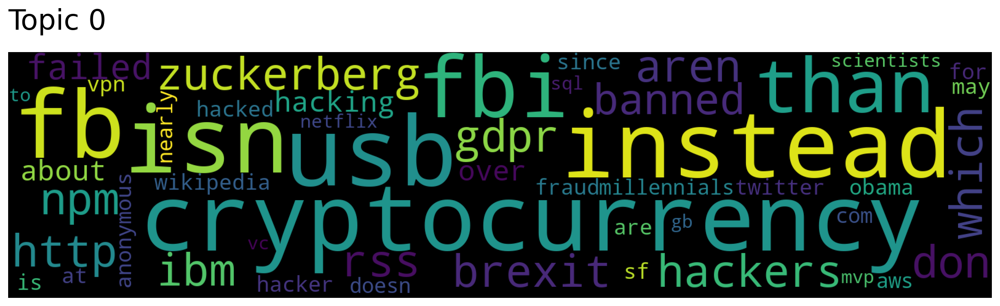

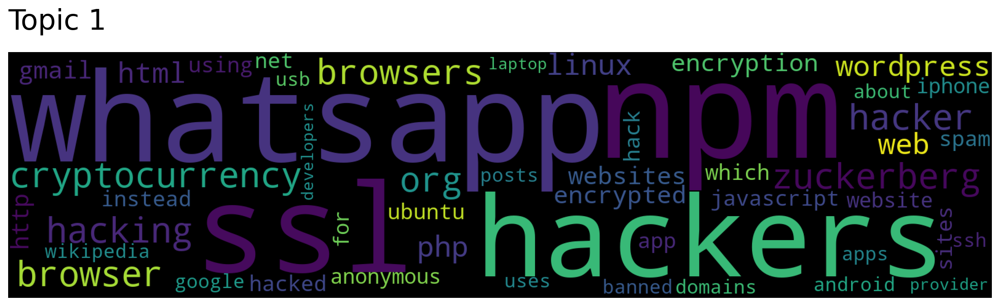

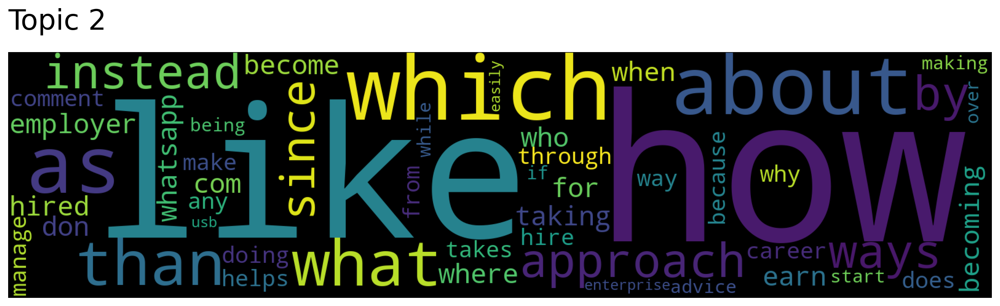

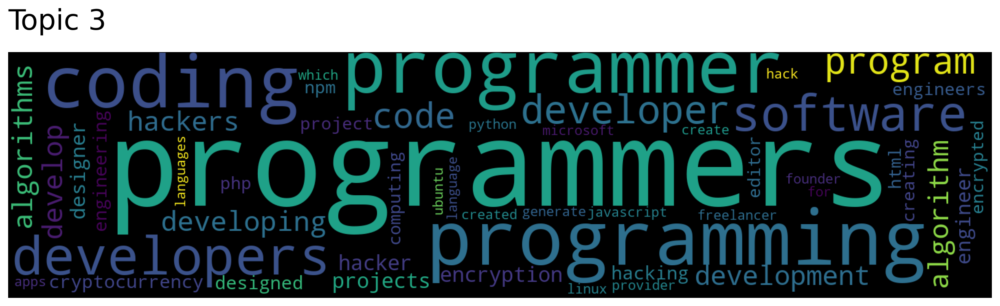

In [ ]:
explain_top2vec(top2vec_models[0])

=======================================================[Topic 0]========================================================
Document 74439      Score 0.65       Pro-Trump CEO  booted from YC over harrassment concerns.                                                                
Document 87688      Score 0.62       How a handful of geeks defied the USSR (2011)                                                                           
Document 1224       Score 0.61       Ubisoft CCO Serge Hascoet resigns in wake of sweeping allegations                                                       
Document 63756      Score 0.61       Volkswagen Reaches Deal in U.S. Over Emissions Scandal                                                                  
Document 38543      Score 0.61       ImPlot: Advanced 2D Plotting for Dear ImGui                                                                             
Document 13334      Score 0.60       KLM to Lay Off 5k Employees Due to Covid-19         

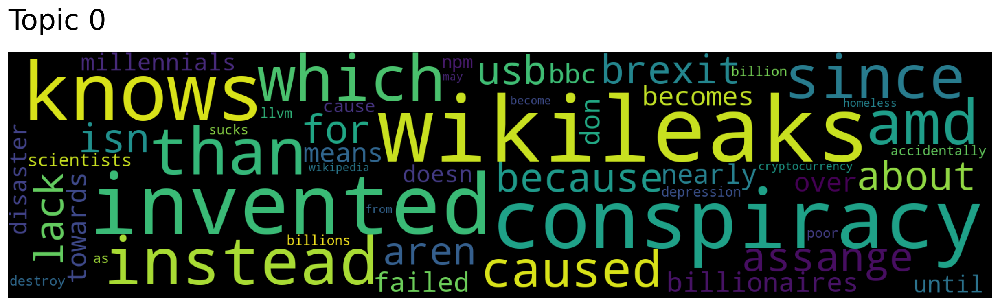

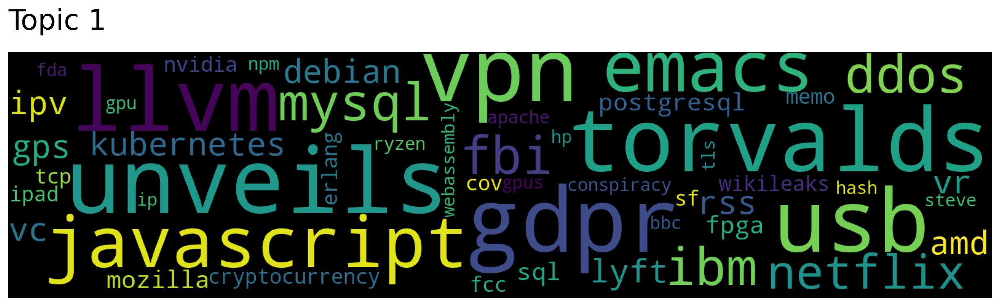

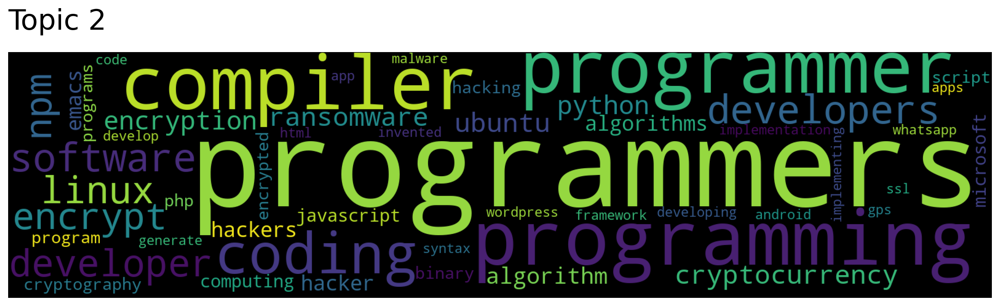

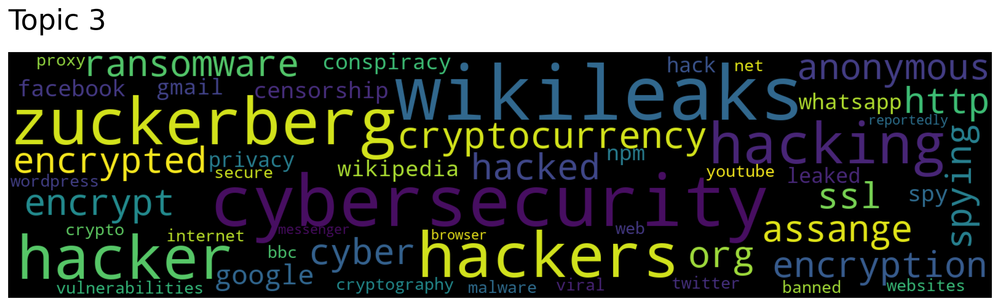

In [ ]:
explain_top2vec(top2vec_models[1])

=======================================================[Topic 0]========================================================
Document 34571      Score 0.63       Yale scientists make a borophene breakthrough                                                                           
Document 8975       Score 0.63       OCaml for the Skeptical: OCaml in a Nutshell (2006)                                                                     
Document 10256      Score 0.63       TI Claims Breakthrough in BAW On-Die-Oscillators                                                                        
Document 45687      Score 0.62       Mutiny at HQ Trivia Fails to Oust CEO                                                                                   
Document 58370      Score 0.62       Rebekah Neumann's search for enlightenment fueled WeWork's collapse                                                     
Document 11140      Score 0.61       Scientists cut the tolerable intake of PFAs by 99.9%

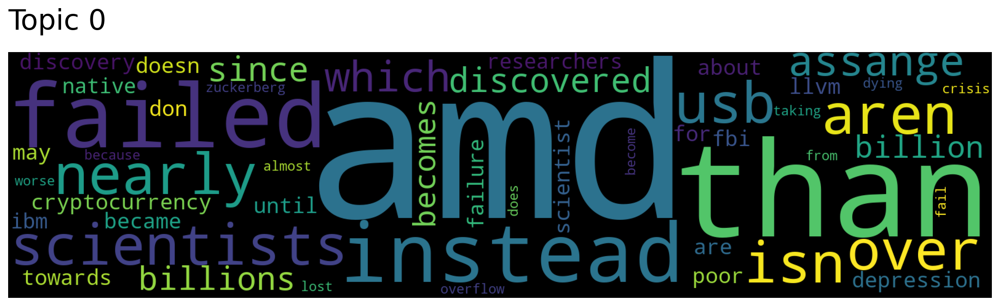

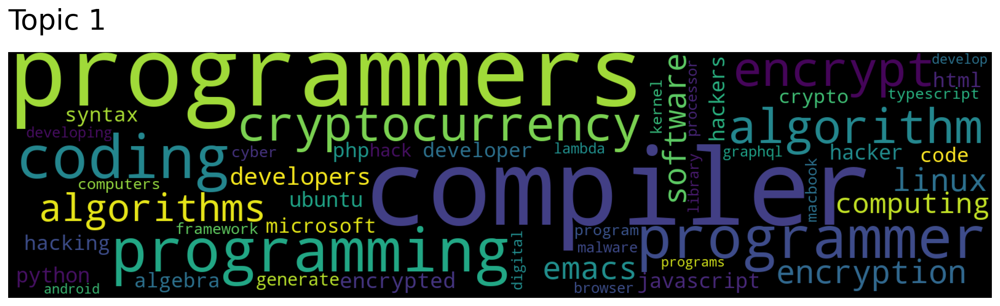

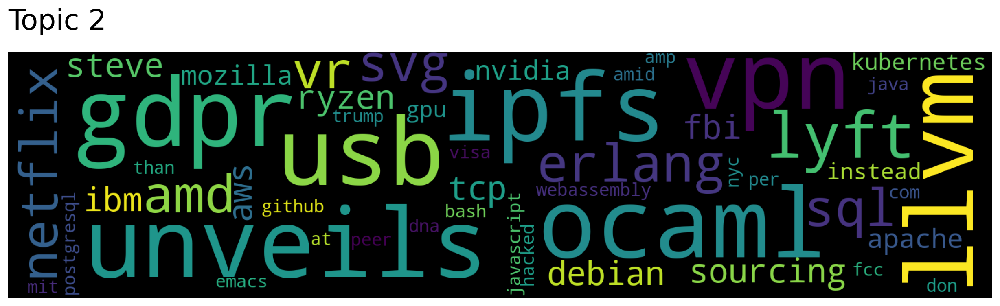

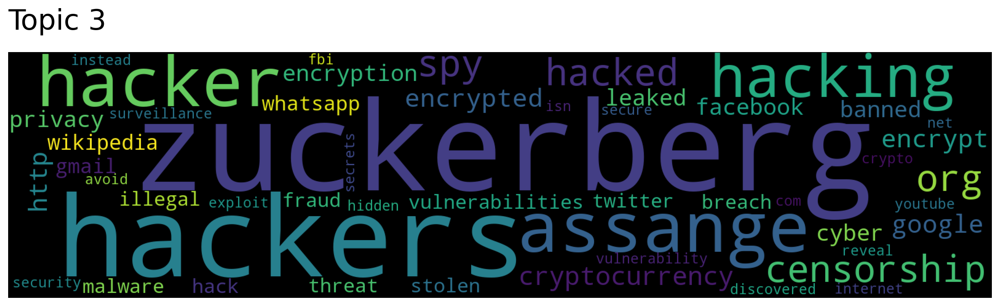

In [ ]:
explain_top2vec(top2vec_models[2])

=======================================================[Topic 0]========================================================
Document 777        Score 0.64       Uber Paid Hackers to Delete Stolen Data on 57M People                                                                   
Document 7          Score 0.61       Hackers take over prominent Twitter accounts in simultaneous attack                                                     
Document 78         Score 0.61       Amazon threatens to suspend Signal's AWS account over censorship circumvention                                          
Document 381        Score 0.61       Cyberattacks in 12 Nations Said to Use Leaked N.S.A. Hacking Tool                                                       
Document 783        Score 0.60       Senators push to ditch social security numbers in light of Equifax hack                                                 
Document 583        Score 0.59       Docker Hub Hacked – 190k accounts, GitHub tokens rev

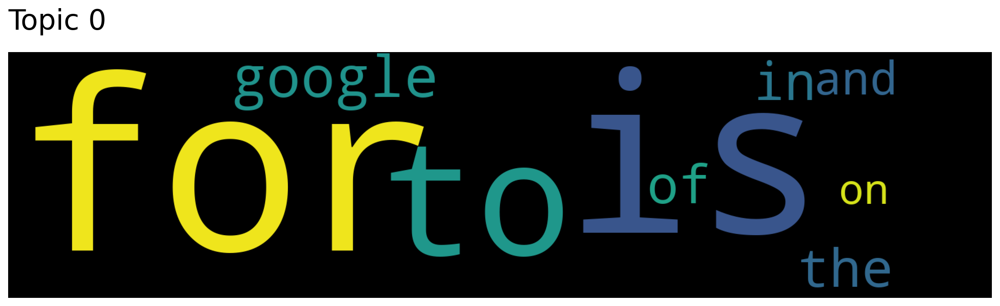

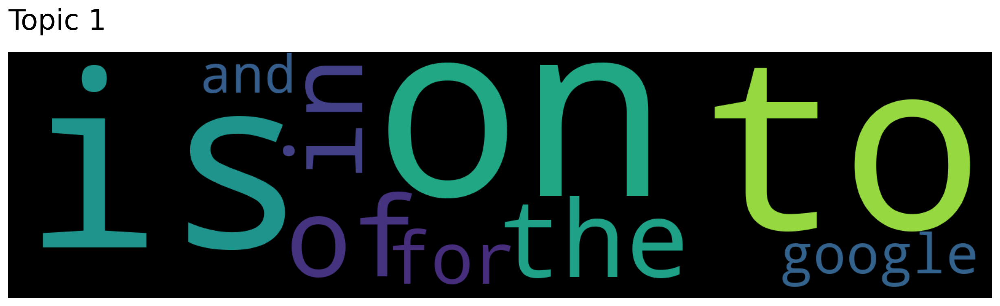

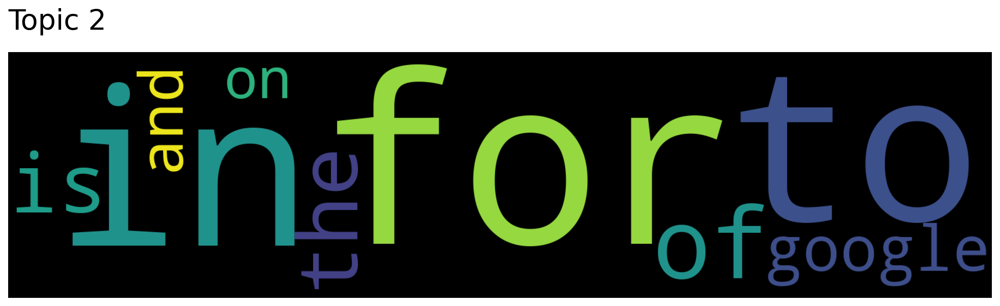

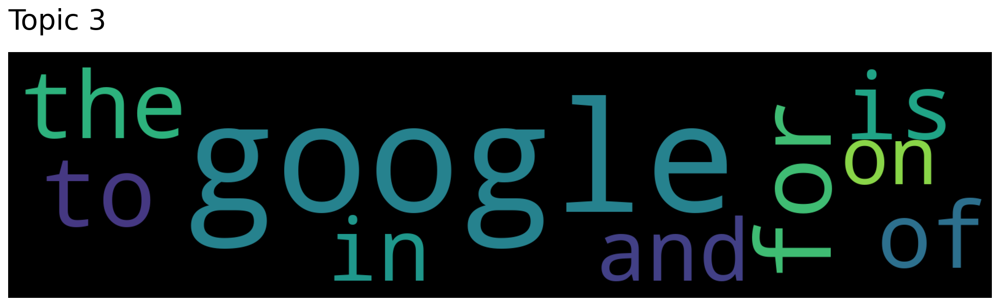

In [ ]:
explain_top2vec(top2vec_models[3])

### LDA

In [ ]:
topic_models_for_classes = {}

for class_id in tqdm(hn_historic_data['score_class'].cat.codes.unique()):
    try:
        model, vis, corpus, representative_docs = explain_topics(hn_historic_data, class_id, model='gensim')
        topic_models_for_classes[class_id] = {
            'model': model, 
            'vis': vis, 
            'representative_docs': representative_docs,
            'corpus': corpus
        }
    except Exception as e:
        print(f"⚠️ Failed for class {class_id}: {repr(e)}")

Training model for class 0
Number of unique tokens: 2925
Number of documents: 62116
Searching for top sentences



Creating visualization
Training model for class 2
Number of unique tokens: 3381
Number of documents: 67619
Searching for top sentences



Creating visualization
Training model for class 3
Number of unique tokens: 8
Number of documents: 836
Searching for top sentences



Creating visualization
Training model for class 1
Number of unique tokens: 4951
Number of documents: 108846
Searching for top sentences



Creating visualization
Training model for class -1
⚠️ Failed for class -1: AttributeError("'float' object has no attribute 'lower'",)



In [ ]:
topic_models_for_classes[0]['representative_docs']

,Topic_Num,Topic_Perc_Contrib,Keywords,Text
0,0.0,0.5707,"new, best, company, like, work, job, project, programming, u, way","BeachfrontDigital, the best way to keep track of your domain names"
1,0.0,0.5237,"new, best, company, like, work, job, project, programming, u, way",What does your ideal programming language look like?
2,0.0,0.5237,"new, best, company, like, work, job, project, programming, u, way","Reddit will allow employees to work from anywhere, going forward"
3,0.0,0.5196,"new, best, company, like, work, job, project, programming, u, way",Elon Musk is annoying the hell out of people who work with self-driving cars
4,0.0,0.5195,"new, best, company, like, work, job, project, programming, u, way",Elon Musk Secretly Visits Jerusalem to See Israeli Self-Driving Car Technology
5,1.0,0.5825,"use, app, startup, web, would, website, service, year, think, idea","No web browsers left in 10 years, or only web browsers left in 10 years?"
6,1.0,0.5139,"use, app, startup, web, would, website, service, year, think, idea",How do you handle server install of a web app for customers?
7,1.0,0.5137,"use, app, startup, web, would, website, service, year, think, idea",I reverse engineered Byte and created my own Byte web app
8,1.0,0.5125,"use, app, startup, web, would, website, service, year, think, idea",What self-hosted PaaS do you use for Rails/Django/Phoenix web apps?
9,1.0,0.4883,"use, app, startup, web, would, website, service, year, think, idea",Sam Altman lost a bold bubble bet made in 2015. Now he must pay $100k


In [ ]:
topic_models_for_classes[1]['representative_docs']

,Topic_Num,Topic_Perc_Contrib,Keywords,Text
0,0.0,0.6097,"google, data, apple, use, facebook, people, language, system, go, one",Google Hacker Asks Tim Cook to Donate $2.5M in Unpaid iPhone Bug Bounties
1,0.0,0.5768,"google, data, apple, use, facebook, people, language, system, go, one",Supreme Court seeks Trump administration views on Google-Oracle copyright feud
2,0.0,0.5638,"google, data, apple, use, facebook, people, language, system, go, one",Survey results: How much would you pay for Facebook without ads?
3,0.0,0.5638,"google, data, apple, use, facebook, people, language, system, go, one",Amazon's cloud is about to announce a huge health-care deal with Cerner
4,0.0,0.5638,"google, data, apple, use, facebook, people, language, system, go, one",Amazon Wants You to Use Alexa to Track Health Care
5,1.0,0.5789,"new, pdf, video, u, world, time, say, make, software, get",Antibody Tests Point to Lower Death Rate for the Coronavirus Than First Thought
6,1.0,0.5586,"new, pdf, video, u, world, time, say, make, software, get",US may tie social media to visa applications
7,1.0,0.5586,"new, pdf, video, u, world, time, say, make, software, get",The danger from climate change no longer outweighs risks of nuclear accidents
8,1.0,0.5585,"new, pdf, video, u, world, time, say, make, software, get",Prompt debuts “a command line for the real world”
9,1.0,0.5585,"new, pdf, video, u, world, time, say, make, software, get",Batteries that “drink” seawater could power long-range underwater vehicles


In [ ]:
topic_models_for_classes[2]['representative_docs']

,Topic_Num,Topic_Perc_Contrib,Keywords,Text
0,0.0,0.6153,"open, learning, source, time, pdf, code, programming, language, open_source, machine",Build a DIY license plate reader with machine learning
1,0.0,0.6037,"open, learning, source, time, pdf, code, programming, language, open_source, machine",A curated list of open source applications built with Node.js
2,0.0,0.6037,"open, learning, source, time, pdf, code, programming, language, open_source, machine","Timescale Cloud: Multi-cloud, fully-managed time-series in AWS, Azure, and GCP"
3,0.0,0.6037,"open, learning, source, time, pdf, code, programming, language, open_source, machine",Facebook's Open-Source Reinforcement Learning Platform – A Deep Dive
4,0.0,0.5942,"open, learning, source, time, pdf, code, programming, language, open_source, machine",Object Storage: AWS vs Google Cloud Storage vs Azure Storage vs DigitalOcean
5,1.0,0.5974,"year, using, web, go, software, python, work, rust, startup, one",A software engineering manager guide to measuring an engineer’s performance
6,1.0,0.5974,"year, using, web, go, software, python, work, rust, startup, one",One Year in San Francisco as a Software Engineer
7,1.0,0.5974,"year, using, web, go, software, python, work, rust, startup, one",Using React Native: One Year Later
8,1.0,0.5721,"year, using, web, go, software, python, work, rust, startup, one",Guide to becoming a modern front end developer
9,1.0,0.5721,"year, using, web, go, software, python, work, rust, startup, one",Sanic – Python 3.5+ web server that's written to go fast


In [ ]:
topic_models_for_classes[3]['representative_docs']

,Topic_Num,Topic_Perc_Contrib,Keywords,Text
0,0.0,0.7298,"year, user, facebook, google, apple, open, amazon, data","Zoom lied to users about end-to-end encryption for years, FTC says"
1,0.0,0.7262,"year, user, facebook, google, apple, open, amazon, data",Facebook Stored Hundreds of Millions of User Passwords in Plain Text for Years
2,0.0,0.5988,"year, user, facebook, google, apple, open, amazon, data",Arwes – Futuristic Sci-Fi / Cyberpunk Graphical User Interface Framework
3,0.0,0.5988,"year, user, facebook, google, apple, open, amazon, data",Am I the longest-serving programmer – 57 years and counting?
4,0.0,0.5988,"year, user, facebook, google, apple, open, amazon, data",94-year-old Lithium-Ion Battery Inventor Introduces Solid State Battery
5,1.0,0.7599,"google, facebook, year, open, apple, user, amazon, data",We are Google employees – Google must drop Dragonfly
6,1.0,0.7599,"google, facebook, year, open, apple, user, amazon, data",Jury in Oracle v. Google finds in Google's favour
7,1.0,0.7599,"google, facebook, year, open, apple, user, amazon, data",Google terminated our business via our Google Play Developer Account
8,1.0,0.7599,"google, facebook, year, open, apple, user, amazon, data",Modifications to Google Chromium for removing Google integration
9,1.0,0.6434,"google, facebook, year, open, apple, user, amazon, data",Sundar will be the CEO of both Google and Alphabet


In [ ]:
topic_models_for_classes[0]['vis']

PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
3      0.402329  0.085318       1        1  29.980453
2     -0.217371  0.344240       2        1  26.161458
0     -0.099310 -0.271619       3        1  22.769951
1     -0.085648 -0.157938       4        1  21.088138, topic_info=           Term         Freq        Total Category  logprob  loglift
7           new  1700.000000  1700.000000  Default  30.0000  30.0000
45          use  1497.000000  1497.000000  Default  29.0000  29.0000
90       google  1556.000000  1556.000000  Default  28.0000  28.0000
27         best  1324.000000  1324.000000  Default  27.0000  27.0000
242         app  1194.000000  1194.000000  Default  26.0000  26.0000
..          ...          ...          ...      ...      ...      ...
893    building   343.037409   343.834705   Topic4  -5.0995   1.5541
677    database   328.729173   329.545319   Topic4  -5.1422   1.5540
971        test   317.669038   318.462885   Topic4  -5.1764   1.5540
196        much   310.451543   311.240894   Topic4  -5.1994   1.5539
100  blockchain   318.733013   319.551112   Topic4  -5.1730   1.5539

[151 rows x 6 columns], token_table=      Topic      Freq     Term
term                          
203       2  0.999020       ai
265       1  0.998582   amazon
454       4  0.998553   anyone
400       1  0.999116      api
242       4  0.999251      app
...     ...       ...      ...
297       3  0.999166     work
648       3  0.998793  working
226       4  0.999287    world
694       4  0.999468    would
166       4  0.998699     year

[121 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[4, 3, 1, 2])

In [ ]:
topic_models_for_classes[1]['vis']

PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
0     -0.342204 -0.187155       1        1  28.799619
1      0.331867 -0.207825       2        1  28.062369
3      0.012834  0.385585       3        1  25.465247
2     -0.002498  0.009395       4        1  17.672765, topic_info=           Term         Freq        Total Category  logprob  loglift
78          new  3437.000000  3437.000000  Default  30.0000  30.0000
256      google  2533.000000  2533.000000  Default  29.0000  29.0000
137        year  1884.000000  1884.000000  Default  28.0000  28.0000
1          open  1475.000000  1475.000000  Default  27.0000  27.0000
170         pdf  1848.000000  1848.000000  Default  26.0000  26.0000
...         ...          ...          ...      ...      ...      ...
659        part   445.754140   446.534879   Topic4  -5.2874   1.7314
192     quantum   433.387446   434.174654   Topic4  -5.3156   1.7313
539         let   424.652910   425.439734   Topic4  -5.3359   1.7313
359   algorithm   407.969888   408.753812   Topic4  -5.3760   1.7312
1440    working   395.369703   396.152949   Topic4  -5.4074   1.7312

[151 rows x 6 columns], token_table=      Topic      Freq       Term
term                            
858       3  0.999124         ai
359       4  0.998156  algorithm
726       1  0.999040     amazon
894       1  0.998140    america
346       2  0.999318   american
...     ...       ...        ...
823       4  0.999282       work
1440      4  0.997090    working
333       2  0.999752      world
893       1  0.999335      would
137       3  0.999666       year

[121 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[1, 2, 4, 3])

In [ ]:
topic_models_for_classes[2]['vis']

PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
2      0.397849 -0.089805       1        1  27.917686
3     -0.226856 -0.324363       2        1  26.406439
1     -0.096489  0.318288       3        1  23.101469
0     -0.074503  0.095880       4        1  22.574407, topic_info=                  Term         Freq        Total Category  logprob  loglift
14                 new  2074.000000  2074.000000  Default  30.0000  30.0000
12              google  1782.000000  1782.000000  Default  29.0000  29.0000
223               open  1373.000000  1373.000000  Default  28.0000  28.0000
29                year  1267.000000  1267.000000  Default  27.0000  27.0000
341               data  1308.000000  1308.000000  Default  26.0000  26.0000
...                ...          ...          ...      ...      ...      ...
94    machine_learning   379.816904   380.578271   Topic4  -5.1354   1.4864
1347              best   386.142981   386.923649   Topic4  -5.1189   1.4863
496               real   369.270436   370.042819   Topic4  -5.1635   1.4863
603           platform   363.952602   364.724481   Topic4  -5.1780   1.4862
1304             intel   346.628847   347.402730   Topic4  -5.2268   1.4861

[151 rows x 6 columns], token_table=      Topic      Freq      Term
term                           
159       1  0.997722        ad
1022      4  0.998339        ai
77        1  0.999171    amazon
50        2  0.998955  american
308       1  0.998347       app
...     ...       ...       ...
913       4  0.998991    window
186       1  0.996663   without
40        3  0.999312      work
158       2  0.998663     world
29        3  0.999595      year

[121 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[3, 4, 2, 1])

In [ ]:
topic_models_for_classes[3]['vis']

PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
1     -0.272563 -0.097242       1        1  35.210257
2      0.319223 -0.229071       2        1  30.049559
0     -0.175260 -0.015322       3        1  20.596359
3      0.128601  0.341636       4        1  14.143824, topic_info=       Term       Freq      Total Category  logprob  loglift
4      data  34.000000  34.000000  Default   8.0000   8.0000
1    google  62.000000  62.000000  Default   7.0000   7.0000
7      year  25.000000  25.000000  Default   6.0000   6.0000
0     apple  33.000000  33.000000  Default   5.0000   5.0000
2      user  23.000000  23.000000  Default   4.0000   4.0000
6      open  25.000000  25.000000  Default   3.0000   3.0000
5    amazon  19.000000  19.000000  Default   2.0000   2.0000
3  facebook  31.000000  31.000000  Default   1.0000   1.0000
1    google  61.622799  62.477422   Topic1  -0.3725   1.0301
3  facebook  26.442330  31.024734   Topic1  -1.2185   0.8840
5    amazon   0.223695  19.699036   Topic1  -5.9910  -3.4342
2      user   0.226493  23.240717   Topic1  -5.9785  -3.5871
6      open   0.232124  25.025687   Topic1  -5.9540  -3.6366
7      year   0.232880  25.351187   Topic1  -5.9507  -3.6462
0     apple   0.230178  33.016503   Topic1  -5.9624  -3.9221
4      data   0.223560  34.164716   Topic1  -5.9916  -3.9854
0     apple  32.168714  33.016503   Topic2  -0.8640   1.1763
6      open  24.179782  25.025687   Topic2  -1.1495   1.1679
5    amazon  18.861213  19.699036   Topic2  -1.3979   1.1589
2      user   0.222300  23.240717   Topic2  -5.8387  -3.4473
7      year   0.222774  25.351187   Topic2  -5.8366  -3.5321
3  facebook   0.223338  31.024734   Topic2  -5.8341  -3.7315
4      data   0.223702  34.164716   Topic2  -5.8325  -3.8263
1    google   0.224058  62.477422   Topic2  -5.8309  -4.4283
7      year  24.547608  25.351187   Topic3  -0.7567   1.5478
2      user  22.438839  23.240717   Topic3  -0.8465   1.5449
3  facebook   3.982344  31.024734   Topic3  -2.5754  -0.4729
5    amazon   0.265262  19.699036   Topic3  -5.2843  -2.7275
6      open   0.265689  25.025687   Topic3  -5.2827  -2.9653
0     apple   0.269759  33.016503   Topic3  -5.2675  -3.2272
4      data   0.265161  34.164716   Topic3  -5.2847  -3.2786
1    google   0.280086  62.477422   Topic3  -5.2299  -3.8274
4      data  33.452293  34.164716   Topic4  -0.0713   1.9348
5    amazon   0.348865  19.699036   Topic4  -4.6345  -2.0777
2      user   0.353084  23.240717   Topic4  -4.6225  -2.2311
6      open   0.348091  25.025687   Topic4  -4.6367  -2.3193
7      year   0.347926  25.351187   Topic4  -4.6372  -2.3327
3  facebook   0.376722  31.024734   Topic4  -4.5577  -2.4551
0     apple   0.347853  33.016503   Topic4  -4.6374  -2.5971
1    google   0.350479  62.477422   Topic4  -4.6299  -3.2274, token_table=      Topic      Freq      Term
term                           
5         2  0.964514    amazon
0         2  0.969212     apple
4         4  0.965909      data
3         1  0.838041  facebook
3         3  0.128929  facebook
1         1  0.992358    google
6         2  0.959015      open
2         3  0.946615      user
7         3  0.986147      year, R=8, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[2, 3, 1, 4])

#### Wordclouds

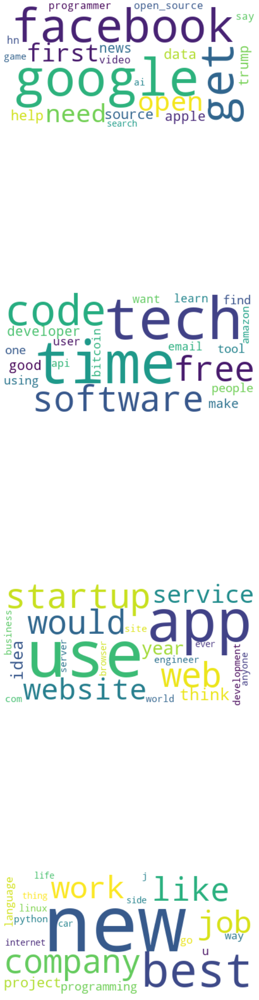

In [ ]:
render_wordclouds(topic_models_for_classes[0]['model'], topic_models_for_classes[0]['corpus'])

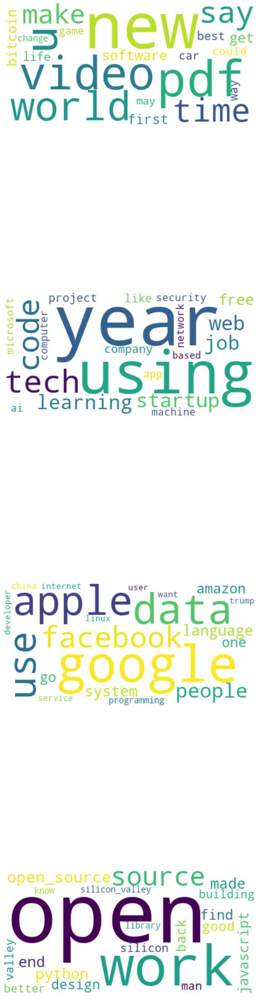

In [ ]:
render_wordclouds(topic_models_for_classes[1]['model'], topic_models_for_classes[1]['corpus'])

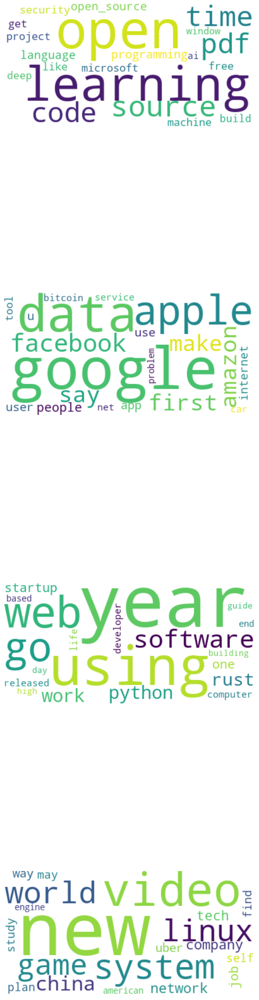

In [ ]:
render_wordclouds(topic_models_for_classes[2]['model'], topic_models_for_classes[2]['corpus'])

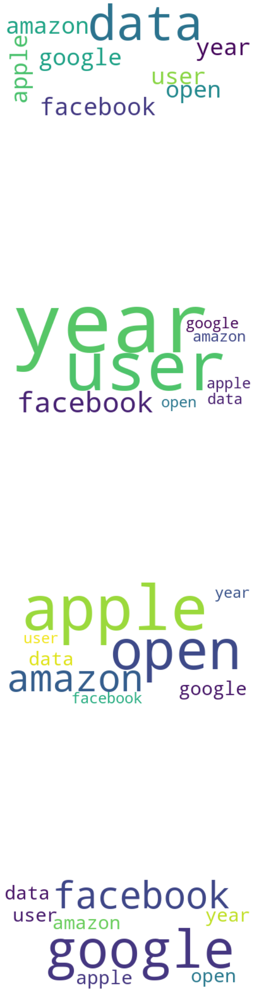

In [ ]:
render_wordclouds(topic_models_for_classes[3]['model'], topic_models_for_classes[3]['corpus'])